### Drydown model

- runs on an individual pixel and season for multiple models
- process an entire datasets

In [2]:
from climate_utils import global_mean


In [3]:
import numpy as np
import pandas as pd
import xarray as xr

# progress bars for loops
from tqdm.notebook import tqdm  


## for model calculation
from scipy.optimize import least_squares
from sklearn.metrics import r2_score

import traceback

## for plotting
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.dates as mdates
import matplotlib.gridspec as gridspec
import matplotlib.patches as mpatches
import matplotlib.lines as mlines
from matplotlib.lines import Line2D
from matplotlib.legend_handler import HandlerTuple
import string



from dataclasses import dataclass, field

from os.path import exists
import glob




## Drydown Model 

In [4]:
@dataclass
class DrydownModel:
    t: np.ndarray
    P_values: np.ndarray
    M_obs: np.ndarray
    lambda_guess: float 
    a_guess: float 
        
    M_pred: np.ndarray = field(default = None, init = False)
    
    def euler_method(self, t, P_values, M_obs, lam, a):
        '''
        Using Euler's method to solve the ODE
        
        Args:
            t (array): Time array.
            P_values (array): Precipitation values.
            lam (float): lambda parameter. Time to drydown to 0 after precipitation 
            a (float): Alpha parameter. Amount of precipitation that infuses into the soil moisture layer.
        
        Returns:
            array: Predicted soil moisture values.
    
        ### code help: https://pythonnumericalmethods.studentorg.berkeley.edu/notebooks/chapter22.03-The-Euler-Method.html
        ### math help: https://math.libretexts.org/Courses/Monroe_Community_College/MTH_225_Differential_Equations/03%3A_Numerical_Methods/3.01%3A_Euler's_Method
        
        '''
        
        M_pred = np.zeros(len(t))
        M_init = M_obs[0]
        M_pred[0] = M_init
        
        for i in range(1, len(t)):
            dt = t[i] - t[i-1]
            
            dM_dt = a * P_values[i-1] - M_pred[i-1] / lam
            M_pred[i] = M_pred[i-1] + dM_dt * dt
            
            
        return M_pred
    

    def objective(self, params):
        """
        Objective function for optimization to minimize residuals.

        Args:
            params (array): Parameters to optimize (lam and a).

        Returns:
            array: Residuals between observed and predicted values.
        """

        lam = np.exp(params[0])
        a = np.exp(params[1])

        self.M_pred = self.euler_method(self.t, self.P_values, self.M_obs, lam, a)

        residuals = self.M_obs - self.M_pred
        
        return residuals 
    
    def fit_params(self):
        '''
        Fit lambda and a using scipy.optimize.least_squares

        Returns:
            tuple: fitted lam and a parameters
        '''
        initial_guess = np.log([self.lambda_guess, self.a_guess])
        bounds = (np.log([1e-3, 1e-3]), np.log([1e3, 1e0]))

        result = least_squares(self.objective, initial_guess, bounds=bounds,
                               ## method = 'trf' : "Trust Region Reflective algorithm, 
                               ## particularly suitable for large sparse problems with bounds. 
                               ## Generally robust method."
                               method='trf', ftol=1e-8, xtol=1e-8)
                               ##method = 'lm')
                               ## Levenberg-Marquardt algorithm as implemented in MINPACK. 
                               ## Doesn’t handle bounds and sparse Jacobians. Usually the 
                               ## most efficient method for small unconstrained problems.
                               #method = 'lm', ftol = 1e-8, xtol=1e-8)
        
        fitted_params = np.exp(result.x)
        return fitted_params

    def calculate_r2(self):
        """
        Calculate the R² value of the model fit.

        Returns:
            float: R² value.
        """
        if self.M_pred is None:
            raise ValueError("Predicted values M_pred are not available. Run fit_params first.")
        return r2_score(self.M_obs, self.M_pred)

### Defining drydown:

A sensible definition of drydown time might be the time it takes for the soil to return to its initial state $M_0$.  In that case, the drydown time would be
$$\tau =\lambda \ln (1+\alpha/M_0 ).$$
If $\lambda = 100$, for example, it would take 9.5 days for the soil to return to its previous value after increasing by 10\% and 40 days if it increased by 50\%.  These are huge values, though: the maximum day-to-day increase in soil moisture in the MIROC model is about 6\%.  For small x $\ln(1+x) \approx x$ so the drydown time is  $$\tau \approx \frac{\alpha}{M_0}\lambda = \frac{A P}{M_0} \lambda.$$
This makes physical sense: heavy precipitation should moisten the soil more and take longer to dry out.  The drier the soil is to begin with, the longer it will take to return to this ``normal" value.  The drydown time depends on the fraction $A$ of precipitation that gets absorbed by the soil: obviously, if more precip goes to runoff, there will be less in the soil to dry out.

In [5]:
def drydown_params(ds, model, model_params, lambda_guess, a_guess, 
                   debug=False, printout = False, return_M_pred=False):
    """
    Fit the drydown model parameters for the given dataset.

    Args:
        ds (xarray.Dataset): Input dataset containing precipitation and soil moisture data.
        ds_clime: climatology for precipitation and soil moisture data
        model: dataset and/or model name to determine variable names
        model_params: parameters for dataset and/or model 
        lambda_guess (float): Initial guess for lambda parameter.
        a_guess (float, optional): Initial guess for a parameter.
        model_version (str): Version of the model ('v1', 'v2', or 'v3').
        debug (bool): Print debug information if True.
        printout (bool): Print the results if True.

    Returns:
        tuple: Fitted parameters, drydown time, and R² value.
    """

    p_var = model_params[model]['p_var']
    s_var = model_params[model]['s_var']

    P = ds[p_var].data
    M = ds[s_var].data
    t = np.linspace(0, len(M)-1, len(M))

    if debug == True:
        print(f"Length of P: {len(P)}, Length of M: {len(M)}, Length of t: {len(t)}")
        print(f"First 10 M values: {M[:10]}")  

    # Initialize model with parameter guesses
    model = DrydownModel(t, P, M, lambda_guess, a_guess)
    fitted_params = model.fit_params()
    
    # Unpack fitted parameters 
    fitted_lambda, fitted_a = fitted_params
    
    M_predicted = model.M_pred

    r2 = model.calculate_r2()


    p_div_m = ds['mean_p_div_m'].data
    ## tau = lambda * np.log(1 + a * seasonal_P_mean/seasonal_M_mean)
    tau = fitted_lambda * np.log(1 + (fitted_a * p_div_m))

     # Print output if requested
    if printout:
        print(f"lambda: {fitted_lambda}")
        print(f"a: {fitted_a}")
        print(f"R²: {r2}")
        print(f"tau (drydown): {tau}")

    # Return results with flexibility for M_pred if requested
    if return_M_pred:
        return tau, fitted_lambda, fitted_a, r2, M_predicted
    else:
        return tau, fitted_lambda, fitted_a, r2

## Import Data

In [6]:
dict_ds = {'MERRA2': {}, 
           'NLDAS_MOS': {}, 
           'NLDAS_NOAH': {}
       }

proj_dir = '/Users/miriam/Documents/02_academia/02_PhD/research/projects/drydown-model/'
filtered_seasons_dir = proj_dir + 'filtered_seasons/'
fig_save_dir = proj_dir + 'figures/'

In [7]:
model_params = {'MERRA2': {'filename': 'MERRA2_warm-season_1980-2023.nc', 
                           'p_var': 'PRECTOTLAND', 
                           't_var': 'T2MMEAN', 
                           'sf_var': 'SFMC',
                           'rz_var': 'RZMC',
                           'snowfall_var': 'PRECSNOLAND', 
                           'snowdepth_var': 'SNODP', 
                           'model_name': 'MERRA-2'
                          },
                 'NLDAS_MOS': {'filename': 'NLDAS_MOS_warm-season_1980-2023.nc', 
                           'p_var': 'Rainf', 
                           't_var': 'Tair', 
                           'sf_var': 'SoilM_0_10cm',
                           'rz_var': 'SoilM_0_100cm',
                           'snowfall_var': 'Snowf', 
                           'snowdepth_var': 'SnowDepth', 
                               'model_name': 'NLDAS-2 MOSAIC'          
                          },
                'NLDAS_NOAH': {'filename': 'NLDAS_NOAH_warm-season_1980-2023.nc', 
                           'p_var': 'Rainf', 
                           't_var': 'Tair', 
                           'sf_var': 'SoilM_0_10cm',
                           'rz_var': 'SoilM_0_100cm',
                           'snowfall_var': 'Snowf', 
                           'snowdepth_var': 'SnowDepth', 
                               'model_name': 'NLDAS-2 NOAH'
                          }
               }

### Choose surface or rootzone for primary soil moisture variable

In [8]:
for model in model_params.keys():
    model_params[model]['s_var'] = model_params[model]['sf_var']
    #model_params[model]['s_var'] = model_params[model]['rz_var']

In [9]:
for model in tqdm(dict_ds.keys()):
    print(model)

    ### open seasonal datasets 
    dict_ds[model] = xr.open_mfdataset(filtered_seasons_dir + model_params[model]['filename'], 
                         parallel = True).load()
    
    # ## typical moisture infusion for the entire time period 
    dict_ds[model]['mean_p_div_m'] = (dict_ds[model][model_params[model]['p_var']]/dict_ds[model][model_params[model]['s_var']]).mean(dim = 'time')
    dict_ds[model]['median_p_div_m'] = (dict_ds[model][model_params[model]['p_var']]/dict_ds[model][model_params[model]['s_var']]).median(dim = 'time')





  0%|          | 0/3 [00:00<?, ?it/s]

MERRA2
NLDAS_MOS
NLDAS_NOAH


## Single Pixel Runs

### Model Fitting well example
in MERRA2 - California - 2004

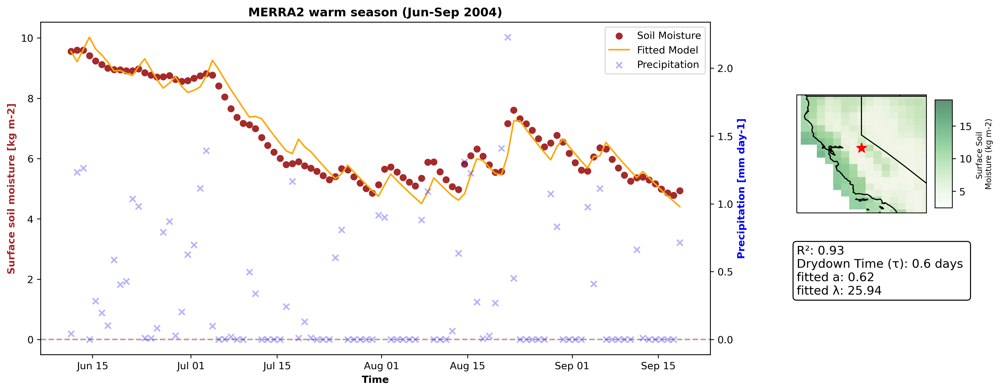

In [11]:
model = 'MERRA2'
lat, lon  = 38, -120
year = '2004'
lambda_guess = 200
a_guess = 0.01

if 'year' in dict_ds[model].dims:
    ds = dict_ds[model].sel(time = year).sel(year = int(year)).sel(lat = lat, lon = lon, method = 'nearest').dropna(dim="time", how="any")  # Drops NaN values along time dimension
else: 
    ds = dict_ds[model].sel(time = year).sel(lat = lat, lon = lon, method = 'nearest').dropna(dim="time", how="any")  # Drops NaN values along time dimension

tau, fitted_lambda, fitted_a, r2, M_predicted = drydown_params(ds, model, model_params, lambda_guess, a_guess, debug=False, printout = False, return_M_pred=True)

ds['M_predicted'] = ('time', M_predicted)



fig, ax1 = plt.subplots(figsize = (12,6), dpi=300)

lns1 = ds[model_params[model]['s_var']].plot.scatter(x = 'time', marker = 'o', label='Soil Moisture', color='brown', ax = ax1)
lns2 = ds['M_predicted'].plot(label='Fitted Model', color='orange', ax = ax1)

ax1.set_ylabel('Surface soil moisture [' + ds[model_params[model]['s_var']].units + ']', color='brown', weight='bold')
ax1.axhline(y=0, linestyle='--', color='brown', alpha=0.5)
ax1.set_title(None)

## add precipitation on a secondary axis
ax2 = ax1.twinx()  # instantiate a second Axes that shares the same x-axis
lns3 = ds[model_params[model]['p_var']].plot.scatter(x = 'time', marker ='x', label='Precipitation', color='blue', alpha=0.3, ax = ax2)

ax2.set_ylabel('Precipitation [' + ds[model_params[model]['p_var']].units + ']', color='blue',  weight='bold')
ax2.set_title(None)

# make a legend for both axis
lns = [lns1, lns2[0], lns3]
labs = [l.get_label() for l in lns]
ax1.legend(lns, labs, loc=0)

ax1.set_xlabel('Time', weight='bold')

#ax1.xaxis.set_major_locator(mdates.MonthLocator(bymonth=range(1,12,3)))
# you can change the format of the label (now it is 2016-Jan)  
ax1.xaxis.set_major_formatter(mdates.DateFormatter('%b %d'))
plt.setp(ax1.get_xticklabels(), rotation=0) 

for label in ax1.get_xticklabels():
    label.set_horizontalalignment('center')


plt.title(f'{model} warm season ({ds.time[0].dt.strftime("%b").data}-{ds.time[-1].dt.strftime("%b %Y").data})', weight = 'bold')

divider = 0.3  # Adjust this ratio as needed

# Add the map on another axes
map_ax = fig.add_axes([1, 0.4, 0.15, 0.35], projection=ccrs.PlateCarree())   # [left, bottom, width, height]
## if extent for the entire dataset
#map_ax.set_extent([dict_ds[model].lon.min(), dict_ds[model].lon.max(), dict_ds[model].lat.min(), dict_ds[model].lat.max()], crs=ccrs.PlateCarree())
## if extent zoomed in for specific pixels
map_ax.set_extent([-125, -115, 33, 42.1], crs=ccrs.PlateCarree())

map_ax.coastlines('10m')
map_ax.add_feature(cfeature.LAND)
map_ax.add_feature(cfeature.COASTLINE)
map_ax.add_feature(cfeature.STATES)

lon_star = ds.lon.data
lat_star = ds.lat.data

## plot spatial data for reference
im = dict_ds[model][model_params[model]['s_var']].sel(time = year).median(dim='time').plot(
    ax=map_ax, alpha=0.6, cmap='Greens', 
    add_colorbar=False, 
)
map_ax.scatter(lon_star, lat_star, color='red', marker='*', s=100)

# add the colorbar and shrink it to be roughly the size of the plot  
cbar_ax = fig.add_axes([1.16, 0.45, 0.02, 0.25])  # [left, bottom, width, height]
cb = plt.colorbar(im, cax=cbar_ax)
cb.set_label(f"Surface Soil \nMoisture ({ds[model_params[model]['s_var']].attrs['units']})", size = 8)

map_ax.set_xlabel('Longitude')
map_ax.set_ylabel('Latitude')

#tau, fitted_lambda, fitted_a, r2,
# **Add Text Box Below Map**
fig.text(1, 0.25, f"R²: {r2:.2f}\nDrydown Time (τ): {np.round(tau,2)} days \nfitted a: {np.round(fitted_a, 2)} \nfitted λ: {np.round(fitted_lambda, 2)}",
         fontsize=12, bbox=dict(facecolor='white', edgecolor='black', boxstyle='round'))


fig.savefig(f'{fig_save_dir}single_pixel_result_{model}_({lat},{lon})_{year}.png', bbox_inches='tight')
plt.show()

### Comparing Models - Single Pixel Runs

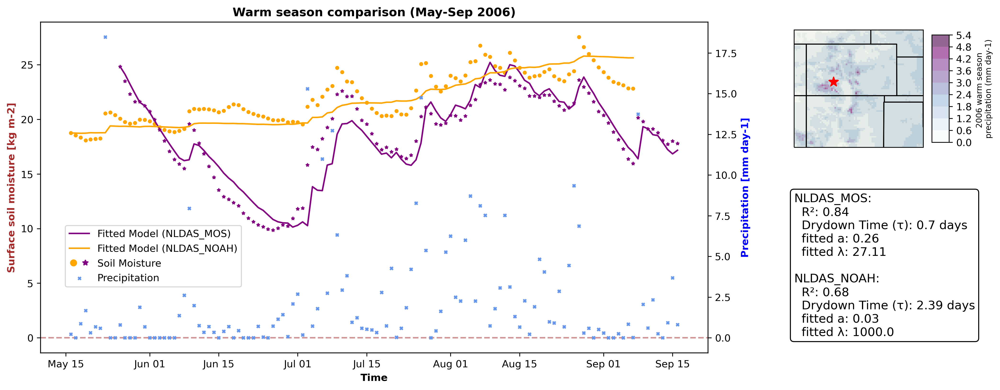

In [12]:
model_compare = {
    'NLDAS_MOS': {},
    'NLDAS_NOAH': {}
}


#lat, lon  = 38, -120
lat, lon  = 38, -107
year = '2006'
lambda_guess = 200
a_guess = 0.01

for model in model_compare.keys():
    if 'year' in dict_ds[model].dims:
        ds = dict_ds[model].sel(time = year).sel(year = int(year)).sel(lat = lat, lon = lon, method = 'nearest').dropna(dim="time", how="any")  # Drops NaN values along time dimension
    else:
        ds = dict_ds[model].sel(time = year).sel(lat = lat, lon = lon, method = 'nearest').dropna(dim="time", how="any")  # Drops NaN values along time dimension

    
    tau, fitted_lambda, fitted_a, r2, M_predicted = drydown_params(ds, model, model_params, lambda_guess, a_guess, debug=False, printout = False, return_M_pred=True)

    ds['M_predicted'] = ('time', M_predicted)

    # update the dictionary
    model_compare[model].update({
        'ds': ds,
        'tau': tau,
        'fitted_lambda': fitted_lambda,
        'fitted_a': fitted_a,
        'r2': r2
    })


fig, ax1 = plt.subplots(figsize=(12, 6), dpi=300)

# Loop through both models to plot their fitted M_predicted values
model_colors = {'NLDAS_NOAH': 'orange', 'NLDAS_MOS': 'purple'}  # Adjust colors as needed
model_markers = {'NLDAS_NOAH': 'o', 'NLDAS_MOS': '*'}
lns1_list = []
lns2_list = []  # To store legend handles

## Add precipitation on a secondary axis
ax2 = ax1.twinx()  

for model in model_compare.keys():
    ds = model_compare[model]['ds']
    
    lns1 = ds[model_params[model]['s_var']].plot.scatter(x='time', marker=model_markers[model], s = 9,  label='Soil Moisture', color=model_colors[model],  ax=ax1)
    lns1_list.append(lns1)
    
    lns2 = ds['M_predicted'].plot(label=f'Fitted Model ({model})', color=model_colors[model], ax=ax1)
    lns2_list.append(lns2[0])

    lns3 = ds[model_params[model]['p_var']].plot.scatter(x='time', marker='x', s = 8, label='Precipitation', color='cornflowerblue', ax=ax2)


ax1.set_ylabel('Surface soil moisture [' + ds[model_params[model]['s_var']].units + ']', color='brown', weight='bold')
ax1.axhline(y=0, linestyle='--', color='brown', alpha=0.5)
ax1.set_title(None)




ax2.set_ylabel('Precipitation [' + ds[model_params[model]['p_var']].units + ']', color='blue', weight='bold')
ax2.set_title(None)

# Create a combined legend
lns = [lns1] + lns2_list + [lns3]
labs = [l.get_label() for l in lns]
#ax1.legend(lns, labs, loc=0)
#ax1.legend(lns, labs, loc='upper left', bbox_to_anchor=(0.03, 0.45))

# Create proxy artists for soil moisture markers.
# Adjust marker style, color, and size as desired.
soil_proxy_circle = Line2D([], [], marker='o', linestyle='None', color=model_colors['NLDAS_NOAH'], markersize=6)
soil_proxy_star = Line2D([], [], marker='*', linestyle='None', color=model_colors['NLDAS_MOS'], markersize=6)

# Combine them into a tuple; this tuple will be handled as a single legend entry.
soil_moisture_proxy = (soil_proxy_circle, soil_proxy_star)

# Now, build the list of legend handles in the desired order.
# For example, suppose you want the two fitted model line entries first:
legend_handles = lns2_list + [soil_moisture_proxy] + [lns3]

# And build the corresponding labels.
# (Assuming the fitted models already have labels.)
fitted_labels = [handle.get_label() for handle in lns2_list]
legend_labels = fitted_labels + ["Soil Moisture"] + ['Precipitation']

# Create the legend.
# Here, handler_map tells Matplotlib to use HandlerTuple to render the tuple proxy.
ax1.legend(
    legend_handles,
    legend_labels,
    handler_map={tuple: HandlerTuple(ndivide=None)},
    loc='upper left',  # or your preferred location
    bbox_to_anchor=(0.03, 0.4)
)

ax1.set_xlabel('Time', weight='bold')

ax1.xaxis.set_major_formatter(mdates.DateFormatter('%b %d'))
plt.setp(ax1.get_xticklabels(), rotation=0)

for label in ax1.get_xticklabels():
    label.set_horizontalalignment('center')

plt.title(f'Warm season comparison ({ds.time[0].dt.strftime("%b").data}-{ds.time[-1].dt.strftime("%b %Y").data})', weight='bold')

# Add the map on another axes
map_ax = fig.add_axes([1, 0.55, 0.15, 0.35], projection=ccrs.PlateCarree())   
map_ax.set_extent([-110, -100, 33, 42.1], crs=ccrs.PlateCarree())

map_ax.coastlines('10m')
map_ax.add_feature(cfeature.LAND)
map_ax.add_feature(cfeature.COASTLINE)
map_ax.add_feature(cfeature.STATES)

lon_star = ds.lon.data
lat_star = ds.lat.data

# Plot spatial data for reference
im = dict_ds[model].sel(time = year).sel(lon = slice(-110, -100), lat = slice(33, 42.1))[model_params[model]['p_var']].mean(dim='time').plot(
    ax=map_ax, alpha=0.6, cmap='BuPu', levels = 9, add_colorbar=False
)
map_ax.scatter(lon_star, lat_star, color='red', marker='*', s=100, zorder=10)


# Add the colorbar
cbar_ax = fig.add_axes([1.16, 0.6, 0.02, 0.25])
cb = plt.colorbar(im, cax=cbar_ax)
cb.set_label(f"{year} warm season \nprecipitation ({ds[model_params[model]['p_var']].attrs['units']})", size=8)

map_ax.set_xlabel('Longitude')
map_ax.set_ylabel('Latitude')

# Create the text box content
text_box_content = "\n\n".join(
    [f"{model}:\n  R²: {model_compare[model]['r2']:.2f}\n  Drydown Time (τ): {np.round(model_compare[model]['tau'], 2)} days\n  fitted a: {np.round(model_compare[model]['fitted_a'], 2)}\n  fitted λ: {np.round(model_compare[model]['fitted_lambda'], 2)}" 
     for model in model_compare.keys()]
)

# Add the text box to the figure
fig.text(1, 0.15, text_box_content, fontsize=12, bbox=dict(facecolor='white', edgecolor='black', boxstyle='round'))

fig.savefig(f'{fig_save_dir}single_pixel_model_comparison_{list(model_compare.keys())[0]}_{list(model_compare.keys())[1]}_({lat},{lon})_{year}.png', bbox_inches='tight')

plt.show()



### Comparing all three models 

2-panel plot

In [54]:
def model_compare_plot(lat, lon, year, text_box = False):
    
    fig, axes = plt.subplots(nrows=2, figsize=(15, 12), dpi=300, sharex=True)
    
    # ---- Dictionary to compare results ---- #
    model_compare = {'MERRA2': {}, 'NLDAS_MOS': {}, 'NLDAS_NOAH': {}}
    lambda_guess, a_guess = 200, 0.01
    
    for model in model_compare.keys():
        # Select data for each model using the same lat, lon, and year
        if 'year' in dict_ds[model].dims:
            ds = dict_ds[model].sel(time=year).sel(year=int(year)).sel(lat=lat, lon=lon, method='nearest').dropna(dim="time", how="any")
        else:
            ds = dict_ds[model].sel(time=year).sel(lat=lat, lon=lon, method='nearest').dropna(dim="time", how="any")
    
        # fit parameters
        tau, fitted_lambda, fitted_a, r2, M_predicted = drydown_params(ds, model, model_params, lambda_guess, a_guess, debug=False, printout=False, return_M_pred=True)
        
        # store results
        ds['M_predicted'] = ('time', M_predicted)
        model_compare[model].update({'ds': ds, 'tau': tau, 'fitted_lambda': fitted_lambda, 'fitted_a': fitted_a, 'r2': r2})
    
    # ---- Top Plot: MERRA-2 ---- #
    ax1 = axes[0]
    ds = model_compare['MERRA2']['ds']
    
    lns1 = ds[model_params['MERRA2']['s_var']].plot.scatter(x='time', marker='o', label='Soil Moisture', color='brown', ax=ax1)
    lns2 = ds['M_predicted'].plot(label='Fitted Model (MERRA-2)', color='midnightblue', ax=ax1)
    
    ax1.set_title(None)
    ax1.set_ylabel('Surface Soil Moisture [kg m$^2$]', color='brown', weight='bold')
    ax1.set_xlabel(None)
    ax1.axhline(y=0, linestyle='--', color='brown', alpha=0.5)
    
    ax2 = ax1.twinx()
    ax2.set_title(None)
    lns3 = ds[model_params['MERRA2']['p_var']].plot.scatter(x='time', marker='x', s=8, label='Precipitation', color='cornflowerblue', ax=ax2)
    
    ax2.set_ylabel('Precipitation [mm day$^{-1}$]', color='blue', weight='bold')
    ax1.legend([lns1, lns2[0], lns3], ['Soil Moisture', 'Fitted Model (MERRA-2)', 'Precipitation'], loc=0)
    plt.title(f'MERRA-2 Warm Season ({ds.time[0].dt.strftime("%b").data} - {ds.time[-1].dt.strftime("%b %Y").data})', weight='bold')
    
    
    # ---- Bottom Plot: NLDAS Models ---- # 
    ax3 = axes[1]
    ax4 = ax3.twinx()
    model_colors = {'NLDAS_NOAH': 'orange', 'NLDAS_MOS': 'purple'}
    model_markers = {'NLDAS_NOAH': 'o', 'NLDAS_MOS': '*'}
    
    lns1_list, lns2_list = [], []
    
    for model, model_name in zip(['NLDAS_MOS', 'NLDAS_NOAH'], ['MOSAIC', 'NOAH']):
        
        ds = model_compare[model]['ds']
        
        lns1 = ds[model_params[model]['s_var']].plot.scatter(x='time', marker=model_markers[model], s=9, label='Soil Moisture', color=model_colors[model], ax=ax3)
        lns1_list.append(lns1)
        
        lns2 = ds['M_predicted'].plot(label=f'Fitted Model ({model_name})', color=model_colors[model], ax=ax3)
        lns2_list.append(lns2[0])
    
        lns3 = ds[model_params[model]['p_var']].plot.scatter(x='time', marker='x', s=8, label='Precipitation', color='cornflowerblue', ax=ax4)
    
    ax3.set_ylabel('Surface Soil Moisture [kg m$^2$]', color='brown', weight='bold')
    ax4.set_ylabel('Precipitation [mm day$^{-1}$]', color='blue', weight='bold')
    ax3.set_title(None)
    ax4.set_title(None)
    ax3.set_xlabel(None)
    ax4.set_xlabel(None)
    
    
    # Create proxy artists for soil moisture markers
    soil_proxy_circle = Line2D([], [], marker='o', linestyle='None', color=model_colors['NLDAS_NOAH'], markersize=6)
    soil_proxy_star = Line2D([], [], marker='*', linestyle='None', color=model_colors['NLDAS_MOS'], markersize=6)
    
    # Group both markers into a tuple for a single legend entry
    soil_moisture_proxy = (soil_proxy_circle, soil_proxy_star)
    
    # Update legend handles & labels
    legend_handles = lns2_list + [lns3, soil_moisture_proxy]
    legend_labels = [handle.get_label() for handle in lns2_list] + ['Precipitation', 'Surface Soil Moisture']
    
    # Apply a custom handler to properly space the combined markers
    ax3.legend(legend_handles, legend_labels, handler_map={tuple: HandlerTuple(ndivide=None)}, 
               loc='upper right')#, bbox_to_anchor=(0.03, 0.25))
    
    ax3.xaxis.set_major_formatter(mdates.DateFormatter('%b %d'))
    plt.setp(ax3.get_xticklabels(), rotation=0)
    
    for label in ax3.get_xticklabels():
        label.set_horizontalalignment('center')
    
    plt.title(f'NLDAS-2 Warm Season ({ds.time[0].dt.strftime("%b").data} - {ds.time[-1].dt.strftime("%b %Y").data})', weight='bold')
    
    
    # ---- Shared Map ----
    map_ax = fig.add_axes([0.15, 0.55, 0.15, 0.30], projection=ccrs.PlateCarree())   # [left, bottom, width, height] 
    ## if extent for the entire dataset
    #map_ax.set_extent([dict_ds[model].lon.min(), dict_ds[model].lon.max(), dict_ds[model].lat.min(), dict_ds[model].lat.max()], crs=ccrs.PlateCarree())
    ## if extent zoomed in for specific pixels
    map_ax.set_extent([-125, -115, 33, 42.1], crs=ccrs.PlateCarree())
    
    map_ax.coastlines('10m')
    map_ax.add_feature(cfeature.LAND)
    map_ax.add_feature(cfeature.COASTLINE)
    map_ax.add_feature(cfeature.STATES)
    
    
    map_ax.scatter(lon, lat, color='darkgreen', marker='*', s=100, label=f'{model} Location')
    
    #map_ax.legend(loc='upper right')
    map_ax.set_xlabel('Longitude')
    map_ax.set_ylabel('Latitude')

    subplot_idx = 0
    for axis in [ax1, ax3]:
        axis.text(0.01, 0.98, string.ascii_lowercase[subplot_idx] + '.', 
                            transform=axis.transAxes, ha='left', va='top',
                            fontsize=15, fontweight='bold',
                            bbox={'boxstyle': 'round',
                                  'facecolor': 'white',
                                  'alpha': 0.8,
                                  'edgecolor': 'None',
                                  'pad': 0.2})
        subplot_idx += 1
    
    if text_box == True:
        # ---- Text Box: Combined Model Info ----
        text_box_content = "\n\n".join(
            [f"{model}:\n  R²: {model_compare[model]['r2']:.2f}\n  Drydown Time (τ): {np.round(model_compare[model]['tau'], 2)} days\n  fitted a: {np.round(model_compare[model]['fitted_a'], 2)}\n  fitted λ: {np.round(model_compare[model]['fitted_lambda'], 2)}"
             for model in model_compare.keys()]
        )
        
        fig.text(0.95, 0.25, text_box_content, fontsize=12, bbox=dict(facecolor='white', edgecolor='black', boxstyle='round'))
        
    
    # ---- Save & Show ----
    fig.savefig(f'{fig_save_dir}combined_drydown_comparison.png', bbox_inches='tight')
    plt.show()
    
    
    ### to do, make map a bit more useful (maybe put inside of top plot)
    ### add lettering to plot 
    ### make version without text box 


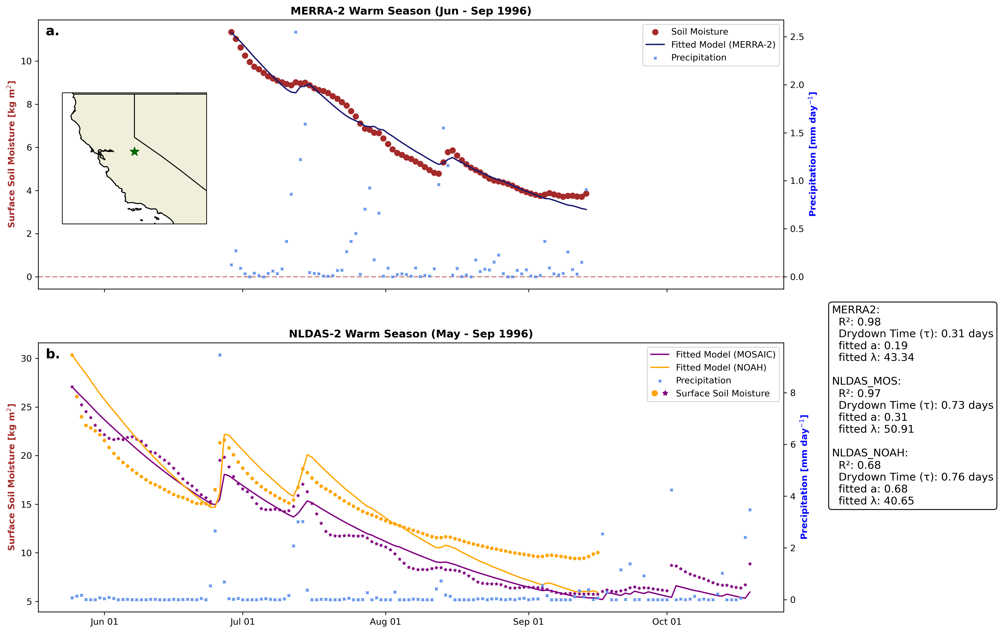

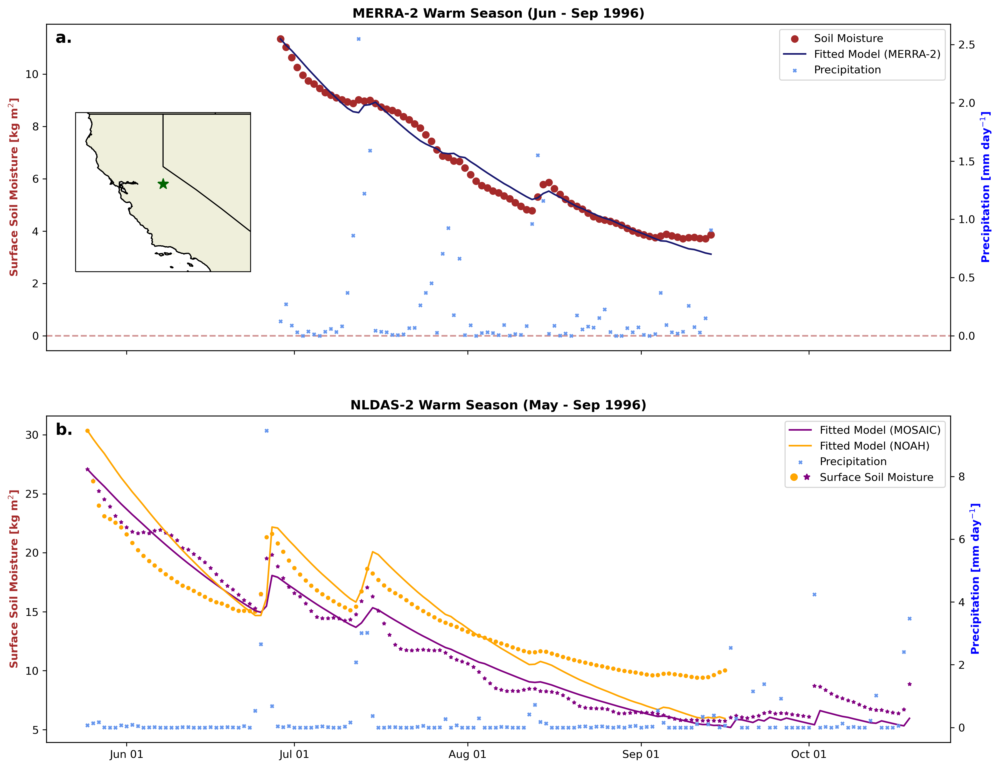

In [55]:
# ---- Location and year to compare plots ---- #
lat, lon  = 38, -120
#lat, lon = 38, -107   
#year = '2007'  
year = '1996'

model_compare_plot(lat, lon, year, text_box = True)
model_compare_plot(lat, lon, year, text_box = False)

### SWE Side Quest

In [ ]:
SWE_data_dir = '/Users/miriam/Documents/02_academia/02_PhD/research/projects/drydown-model/NLDAS/'

dict_SWE = {}

dict_SWE['NLDAS_NOAH'] = xr.open_mfdataset(glob.glob(SWE_data_dir + 'NOAH/NLDAS_NOAH_SWE_' + '*.nc'))
dict_SWE['NLDAS_MOS'] = xr.open_mfdataset(glob.glob(SWE_data_dir + 'MOS/NLDAS_MOS_SWE_' + '*.nc'))

In [ ]:
import datetime

In [ ]:
model_compare = {
    'NLDAS_MOS': {},  
    'NLDAS_NOAH': {}
}


lat, lon  = 38, -107
year = '2006'
lambda_guess = 200
a_guess = 0.01

for model in model_compare.keys():
    if 'year' in dict_ds[model].dims:
        ds = dict_ds[model].sel(time = year).sel(year = int(year)).sel(lat = lat, lon = lon, method = 'nearest').dropna(dim="time", how="any")  # Drops NaN values along time dimension
    else:
        ds = dict_ds[model].sel(time = year).sel(lat = lat, lon = lon, method = 'nearest').dropna(dim="time", how="any")  # Drops NaN values along time dimension

    
    tau, fitted_lambda, fitted_a, r2, M_predicted = drydown_params(ds, model, model_params, lambda_guess, a_guess, debug=False, printout = False, return_M_pred=True)

    ds['M_predicted'] = ('time', M_predicted)

    # update the dictionary
    model_compare[model].update({
        'ds': ds,
        'tau': tau,
        'fitted_lambda': fitted_lambda,
        'fitted_a': fitted_a,
        'r2': r2
    })





fig, ax1 = plt.subplots(figsize=(12, 6), dpi=300)

# Loop through both models to plot their fitted M_predicted values
model_colors = {'NLDAS_NOAH': 'orange', 'NLDAS_MOS': 'purple'}  # Adjust colors as needed
model_markers = {'NLDAS_NOAH': 'o', 'NLDAS_MOS': '*'}
lns1_list = []
lns2_list = []  # To store legend handles

## Add precipitation on a secondary axis
ax2 = ax1.twinx()  

for model in model_compare.keys():
    ds = model_compare[model]['ds']
    
    lns1 = ds[model_params[model]['s_var']].plot.scatter(x='time', marker=model_markers[model], s = 9,  label='Soil Moisture', color=model_colors[model],  ax=ax1)
    lns1_list.append(lns1)
    
    lns2 = ds['M_predicted'].plot(label=f'Fitted Model ({model})', color=model_colors[model], ax=ax1)
    lns2_list.append(lns2[0])

    lns3 = ds[model_params[model]['p_var']].plot.scatter(x='time', marker='x', s = 8, label='Precipitation', color='cornflowerblue', ax=ax2)

    dict_SWE[model].sel(time = year).sel(lat = lat, lon = lon, method = 'nearest').SWE.plot(ax = ax1, color = model_colors[model], linestyle = '--')


ax1.set_ylabel('Surface soil moisture [' + ds[model_params[model]['s_var']].units + ']', color='brown', weight='bold')
ax1.axhline(y=0, linestyle='--', color='brown', alpha=0.5)
ax1.set_title(None)




ax2.set_ylabel('Precipitation [' + ds[model_params[model]['p_var']].units + ']', color='blue', weight='bold')
ax2.set_title(None)

# Create a combined legend
lns = [lns1] + lns2_list + [lns3]
labs = [l.get_label() for l in lns]
#ax1.legend(lns, labs, loc=0)
#ax1.legend(lns, labs, loc='upper left', bbox_to_anchor=(0.03, 0.45))

# Create proxy artists for soil moisture markers.
# Adjust marker style, color, and size as desired.
soil_proxy_circle = Line2D([], [], marker='o', linestyle='None', color=model_colors['NLDAS_NOAH'], markersize=6)
soil_proxy_star = Line2D([], [], marker='*', linestyle='None', color=model_colors['NLDAS_MOS'], markersize=6)

# Combine them into a tuple; this tuple will be handled as a single legend entry.
soil_moisture_proxy = (soil_proxy_circle, soil_proxy_star)

# Now, build the list of legend handles in the desired order.
# For example, suppose you want the two fitted model line entries first:
legend_handles = lns2_list + [soil_moisture_proxy] + [lns3]

# And build the corresponding labels.
# (Assuming the fitted models already have labels.)
fitted_labels = [handle.get_label() for handle in lns2_list]
legend_labels = fitted_labels + ["Soil Moisture"] + ['Precipitation']

# Create the legend.
# Here, handler_map tells Matplotlib to use HandlerTuple to render the tuple proxy.
ax1.legend(
    legend_handles,
    legend_labels,
    handler_map={tuple: HandlerTuple(ndivide=None)},
    loc='upper left',  # or your preferred location
    bbox_to_anchor=(0.03, 0.4)
)

ax1.set_xlabel('Time', weight='bold')

ax1.xaxis.set_major_formatter(mdates.DateFormatter('%b %d'))
plt.setp(ax1.get_xticklabels(), rotation=0)

for label in ax1.get_xticklabels():
    label.set_horizontalalignment('center')

plt.title(f'Warm season comparison ({ds.time[0].dt.strftime("%b").data}-{ds.time[-1].dt.strftime("%b %Y").data})', weight='bold')

# Add the map on another axes
map_ax = fig.add_axes([1, 0.55, 0.15, 0.35], projection=ccrs.PlateCarree())   
map_ax.set_extent([-110, -100, 33, 42.1], crs=ccrs.PlateCarree())

map_ax.coastlines('10m')
map_ax.add_feature(cfeature.LAND)
map_ax.add_feature(cfeature.COASTLINE)
map_ax.add_feature(cfeature.STATES)

lon_star = ds.lon.data
lat_star = ds.lat.data

# Plot spatial data for reference
im = dict_ds[model].sel(time = year).sel(lon = slice(-110, -100), lat = slice(33, 42.1))[model_params[model]['p_var']].mean(dim='time').plot(
    ax=map_ax, alpha=0.6, cmap='BuPu', levels = 9, add_colorbar=False
)
map_ax.scatter(lon_star, lat_star, color='red', marker='*', s=100, zorder=10)


# Add the colorbar
cbar_ax = fig.add_axes([1.16, 0.6, 0.02, 0.25])
cb = plt.colorbar(im, cax=cbar_ax)
cb.set_label(f"{year} warm season \nprecipitation ({ds[model_params[model]['p_var']].attrs['units']})", size=8)

map_ax.set_xlabel('Longitude')
map_ax.set_ylabel('Latitude')

# Create the text box content
text_box_content = "\n\n".join(
    [f"{model}:\n  R²: {model_compare[model]['r2']:.2f}\n  Drydown Time (τ): {np.round(model_compare[model]['tau'], 2)} days\n  fitted a: {np.round(model_compare[model]['fitted_a'], 2)}\n  fitted λ: {np.round(model_compare[model]['fitted_lambda'], 2)}" 
     for model in model_compare.keys()]
)

ax1.set_xlim([datetime.date(2006, 4, 15), datetime.date(2006, 10, 1)])
ax1.set_ylim(0, 30)

# Add the text box to the figure
fig.text(1, 0.15, text_box_content, fontsize=12, bbox=dict(facecolor='white', edgecolor='black', boxstyle='round'))

fig.savefig(f'{fig_save_dir}single_pixel_model_comparison_with-SWE_{list(model_compare.keys())[0]}_{list(model_compare.keys())[1]}_({lat},{lon})_{year}.png', bbox_inches='tight')

plt.show()



### Evaporation Sidequest

In [ ]:
## load in NLDAS evaporation data 
## select for season
## plot 

In [ ]:
dict_evap = {
    'NLDAS_MOS': {},
    'NLDAS_NOAH': {}
}

In [ ]:
for model in dict_evap.keys():
    ds = xr.open_dataset(proj_dir + '/NLDAS/' + model + '_1979-2024.nc')
    dict_evap[model] = ds[['Evap']].where(dict_ds[model][model_params[model]['s_var']].notnull(), drop = True)

In [ ]:
model_compare = {
    'NLDAS_MOS': {},  
    'NLDAS_NOAH': {}
}


lat, lon  = 38, -107
year = '2006'
lambda_guess = 200
a_guess = 0.01

for model in model_compare.keys():
    if 'year' in dict_ds[model].dims:
        ds = dict_ds[model].sel(time = year).sel(year = int(year)).sel(lat = lat, lon = lon, method = 'nearest').dropna(dim="time", how="any")  # Drops NaN values along time dimension
    else:
        ds = dict_ds[model].sel(time = year).sel(lat = lat, lon = lon, method = 'nearest').dropna(dim="time", how="any")  # Drops NaN values along time dimension

    
    tau, fitted_lambda, fitted_a, r2, M_predicted = drydown_params(ds, model, model_params, lambda_guess, a_guess, debug=False, printout = False, return_M_pred=True)

    ds['M_predicted'] = ('time', M_predicted)

    # update the dictionary
    model_compare[model].update({
        'ds': ds,
        'tau': tau,
        'fitted_lambda': fitted_lambda,
        'fitted_a': fitted_a,
        'r2': r2
    })





fig, ax1 = plt.subplots(figsize=(12, 6), dpi=300)

# Loop through both models to plot their fitted M_predicted values
model_colors = {'NLDAS_NOAH': 'orange', 'NLDAS_MOS': 'purple'}  # Adjust colors as needed
model_markers = {'NLDAS_NOAH': 'o', 'NLDAS_MOS': '*'}
lns1_list = []
lns2_list = []  

## Add precipitation on a secondary axis
ax2 = ax1.twinx()  

for model in model_compare.keys():
    ds = model_compare[model]['ds']
    
    lns1 = ds[model_params[model]['s_var']].plot.scatter(x='time', marker=model_markers[model], s = 9,  label='Soil Moisture', color=model_colors[model],  ax=ax1)
    lns1_list.append(lns1)
    
    lns2 = ds['M_predicted'].plot(label=f'Fitted Model ({model})', color=model_colors[model], ax=ax1)
    lns2_list.append(lns2[0])

    lns3 = ds[model_params[model]['p_var']].plot.scatter(x='time', marker='x', s = 8, label='Precipitation', color='cornflowerblue', ax=ax2)

    dict_evap[model].sel(time = year).sel(lat = lat, lon = lon, method = 'nearest').Evap.plot(ax = ax1, color = model_colors[model], linestyle = '--', label = 'Evaporation')


ax1.set_ylabel('Surface soil moisture [' + ds[model_params[model]['s_var']].units + ']', color='brown', weight='bold')
ax1.axhline(y=0, linestyle='--', color='brown', alpha=0.5)
ax1.set_title(None)




ax2.set_ylabel('Precipitation [' + ds[model_params[model]['p_var']].units + ']', color='blue', weight='bold')
ax2.set_title(None)

# Create a combined legend
lns = [lns1] + lns2_list + [lns3]
labs = [l.get_label() for l in lns]
#ax1.legend(lns, labs, loc=0)
#ax1.legend(lns, labs, loc='upper left', bbox_to_anchor=(0.03, 0.45))

# Create proxy artists for soil moisture markers.
# Adjust marker style, color, and size as desired.
soil_proxy_circle = Line2D([], [], marker='o', linestyle='None', color=model_colors['NLDAS_NOAH'], markersize=6)
soil_proxy_star = Line2D([], [], marker='*', linestyle='None', color=model_colors['NLDAS_MOS'], markersize=6)

# Combine them into a tuple; this tuple will be handled as a single legend entry.
soil_moisture_proxy = (soil_proxy_circle, soil_proxy_star)

# Now, build the list of legend handles in the desired order.
# For example, suppose you want the two fitted model line entries first:
legend_handles = lns2_list + [soil_moisture_proxy] + [lns3] #+ [lns4]

# And build the corresponding labels.
# (Assuming the fitted models already have labels.)
fitted_labels = [handle.get_label() for handle in lns2_list]
legend_labels = fitted_labels + ["Soil Moisture"] + ['Precipitation'] 

# Create the legend.
# Here, handler_map tells Matplotlib to use HandlerTuple to render the tuple proxy.
ax1.legend(
    legend_handles,
    legend_labels,
    handler_map={tuple: HandlerTuple(ndivide=None)},
    loc='upper left',  # or your preferred location
    bbox_to_anchor=(0.03, 0.4)
)

ax1.set_xlabel('Time', weight='bold')

ax1.xaxis.set_major_formatter(mdates.DateFormatter('%b %d'))
plt.setp(ax1.get_xticklabels(), rotation=0)

for label in ax1.get_xticklabels():
    label.set_horizontalalignment('center')

plt.title(f'Warm season comparison ({ds.time[0].dt.strftime("%b").data}-{ds.time[-1].dt.strftime("%b %Y").data})', weight='bold')

# Add the map on another axes
map_ax = fig.add_axes([1, 0.55, 0.15, 0.35], projection=ccrs.PlateCarree())   
map_ax.set_extent([-110, -100, 33, 42.1], crs=ccrs.PlateCarree())

map_ax.coastlines('10m')
map_ax.add_feature(cfeature.LAND)
map_ax.add_feature(cfeature.COASTLINE)
map_ax.add_feature(cfeature.STATES)

lon_star = ds.lon.data
lat_star = ds.lat.data

# Plot spatial data for reference
im = dict_ds[model].sel(time = year).sel(lon = slice(-110, -100), lat = slice(33, 42.1))[model_params[model]['p_var']].mean(dim='time').plot(
    ax=map_ax, alpha=0.6, cmap='BuPu', levels = 9, add_colorbar=False
)
map_ax.scatter(lon_star, lat_star, color='red', marker='*', s=100, zorder=10)


# Add the colorbar
cbar_ax = fig.add_axes([1.16, 0.6, 0.02, 0.25])
cb = plt.colorbar(im, cax=cbar_ax)
cb.set_label(f"{year} warm season \nprecipitation ({ds[model_params[model]['p_var']].attrs['units']})", size=8)

map_ax.set_xlabel('Longitude')
map_ax.set_ylabel('Latitude')

# Create the text box content
text_box_content = "\n\n".join(
    [f"{model}:\n  R²: {model_compare[model]['r2']:.2f}\n  Drydown Time (τ): {np.round(model_compare[model]['tau'], 2)} days\n  fitted a: {np.round(model_compare[model]['fitted_a'], 2)}\n  fitted λ: {np.round(model_compare[model]['fitted_lambda'], 2)}" 
     for model in model_compare.keys()]
)

ax1.set_xlim([datetime.date(2006, 4, 15), datetime.date(2006, 10, 1)])
ax1.set_ylim(0, 30)

# Add the text box to the figure
fig.text(1, 0.15, text_box_content, fontsize=12, bbox=dict(facecolor='white', edgecolor='black', boxstyle='round'))

fig.savefig(f'{fig_save_dir}single_pixel_model_comparison_with-evaporation_{list(model_compare.keys())[0]}_{list(model_compare.keys())[1]}_({lat},{lon})_{year}.png', bbox_inches='tight')

plt.show()



### Rootzone Sidequest

In [ ]:
model_compare = {
    'NLDAS_MOS': {},  
    'NLDAS_NOAH': {}
}


lat, lon  = 38, -107
year = '2006'
lambda_guess = 200
a_guess = 0.01

for model in model_compare.keys():
    if 'year' in dict_ds[model].dims:
        ds = dict_ds[model].sel(time = year).sel(year = int(year)).sel(lat = lat, lon = lon, method = 'nearest').dropna(dim="time", how="any")  # Drops NaN values along time dimension
    else:
        ds = dict_ds[model].sel(time = year).sel(lat = lat, lon = lon, method = 'nearest').dropna(dim="time", how="any")  # Drops NaN values along time dimension

    
    tau, fitted_lambda, fitted_a, r2, M_predicted = drydown_params(ds, model, model_params, lambda_guess, a_guess, debug=False, printout = False, return_M_pred=True)

    ds['M_predicted'] = ('time', M_predicted)

    # update the dictionary
    model_compare[model].update({
        'ds': ds,
        'tau': tau,
        'fitted_lambda': fitted_lambda,
        'fitted_a': fitted_a,
        'r2': r2
    })





fig, ax1 = plt.subplots(figsize=(12, 6), dpi=300)

# Loop through both models to plot their fitted M_predicted values
model_colors = {'NLDAS_NOAH': 'orange', 'NLDAS_MOS': 'purple'}  # Adjust colors as needed
model_markers = {'NLDAS_NOAH': 'o', 'NLDAS_MOS': '*'}
lns1_list = []
lns2_list = []  

## Add precipitation on a secondary axis
ax2 = ax1.twinx()  

for model in model_compare.keys():
    ds = model_compare[model]['ds']
    
    lns1 = ds[model_params[model]['s_var']].plot.scatter(x='time', marker=model_markers[model], s = 9,  label='Soil Moisture', color=model_colors[model],  ax=ax1)
    lns1_list.append(lns1)
    
    lns2 = ds['M_predicted'].plot(label=f'Fitted Model ({model})', color=model_colors[model], ax=ax1)
    lns2_list.append(lns2[0])

    lns3 = ds[model_params[model]['p_var']].plot.scatter(x='time', marker='x', s = 8, label='Precipitation', color='cornflowerblue', ax=ax2)

    dict_ds[model].sel(time = year).sel(lat = lat, lon = lon, method = 'nearest')[model_params[model]['rz_var']].plot(ax = ax1, 
                                                                                                                      color = model_colors[model], linestyle = '-.', label = 'Rootzone')


ax1.set_ylabel('Surface soil moisture [' + ds[model_params[model]['s_var']].units + ']', color='brown', weight='bold')
ax1.axhline(y=0, linestyle='--', color='brown', alpha=0.5)
ax1.set_title(None)




ax2.set_ylabel('Precipitation [' + ds[model_params[model]['p_var']].units + ']', color='blue', weight='bold')
ax2.set_title(None)

# Create a combined legend
lns = [lns1] + lns2_list + [lns3]
labs = [l.get_label() for l in lns]
#ax1.legend(lns, labs, loc=0)
#ax1.legend(lns, labs, loc='upper left', bbox_to_anchor=(0.03, 0.45))

# Create proxy artists for soil moisture markers.
# Adjust marker style, color, and size as desired.
soil_proxy_circle = Line2D([], [], marker='o', linestyle='None', color=model_colors['NLDAS_NOAH'], markersize=6)
soil_proxy_star = Line2D([], [], marker='*', linestyle='None', color=model_colors['NLDAS_MOS'], markersize=6)

# Combine them into a tuple; this tuple will be handled as a single legend entry.
soil_moisture_proxy = (soil_proxy_circle, soil_proxy_star)

# Now, build the list of legend handles in the desired order.
# For example, suppose you want the two fitted model line entries first:
legend_handles = lns2_list + [soil_moisture_proxy] + [lns3] #+ [lns4]

# And build the corresponding labels.
# (Assuming the fitted models already have labels.)
fitted_labels = [handle.get_label() for handle in lns2_list]
legend_labels = fitted_labels + ["Soil Moisture"] + ['Precipitation'] 

# Create the legend.
# Here, handler_map tells Matplotlib to use HandlerTuple to render the tuple proxy.
ax1.legend(
    legend_handles,
    legend_labels,
    handler_map={tuple: HandlerTuple(ndivide=None)},
    loc='upper left',  # or your preferred location
    bbox_to_anchor=(0.03, 0.4)
)

ax1.set_xlabel('Time', weight='bold')

ax1.xaxis.set_major_formatter(mdates.DateFormatter('%b %d'))
plt.setp(ax1.get_xticklabels(), rotation=0)

for label in ax1.get_xticklabels():
    label.set_horizontalalignment('center')

plt.title(f'Warm season comparison ({ds.time[0].dt.strftime("%b").data}-{ds.time[-1].dt.strftime("%b %Y").data})', weight='bold')

# Add the map on another axes
map_ax = fig.add_axes([1, 0.55, 0.15, 0.35], projection=ccrs.PlateCarree())   
map_ax.set_extent([-110, -100, 33, 42.1], crs=ccrs.PlateCarree())

map_ax.coastlines('10m')
map_ax.add_feature(cfeature.LAND)
map_ax.add_feature(cfeature.COASTLINE)
map_ax.add_feature(cfeature.STATES)

lon_star = ds.lon.data
lat_star = ds.lat.data

# Plot spatial data for reference
im = dict_ds[model].sel(time = year).sel(lon = slice(-110, -100), lat = slice(33, 42.1))[model_params[model]['p_var']].mean(dim='time').plot(
    ax=map_ax, alpha=0.6, cmap='BuPu', levels = 9, add_colorbar=False
)
map_ax.scatter(lon_star, lat_star, color='red', marker='*', s=100, zorder=10)


# Add the colorbar
cbar_ax = fig.add_axes([1.16, 0.6, 0.02, 0.25])
cb = plt.colorbar(im, cax=cbar_ax)
cb.set_label(f"{year} warm season \nprecipitation ({ds[model_params[model]['p_var']].attrs['units']})", size=8)

map_ax.set_xlabel('Longitude')
map_ax.set_ylabel('Latitude')

# Create the text box content
text_box_content = "\n\n".join(
    [f"{model}:\n  R²: {model_compare[model]['r2']:.2f}\n  Drydown Time (τ): {np.round(model_compare[model]['tau'], 2)} days\n  fitted a: {np.round(model_compare[model]['fitted_a'], 2)}\n  fitted λ: {np.round(model_compare[model]['fitted_lambda'], 2)}" 
     for model in model_compare.keys()]
)

ax1.set_xlim([datetime.date(2006, 4, 15), datetime.date(2006, 10, 1)])

# Add the text box to the figure
fig.text(1, 0.15, text_box_content, fontsize=12, bbox=dict(facecolor='white', edgecolor='black', boxstyle='round'))

fig.savefig(f'{fig_save_dir}single_pixel_model_comparison_with-rootzone_{list(model_compare.keys())[0]}_{list(model_compare.keys())[1]}_({lat},{lon})_{year}.png', bbox_inches='tight')

plt.show()



In [ ]:
plt.figure(figsize=(10, 6))

for model in dict_evap.keys():
    ## looking at the entire dataset average 
    ds = global_mean(dict_evap[model])
    
    # get day of year coordinate
    ds = ds.assign_coords(day_of_year=ds['time'].dt.dayofyear)
    

    
    # Group by year and plot each group separately
    for year, da in ds['Evap'].groupby('time.year'):
        da.plot.line(x='day_of_year', color = model_colors[model],  alpha=0.1)
    
    global_mean(dict_evap[model]).groupby('time.dayofyear').mean()['Evap'].plot(color = model_colors[model], label = model)
    
# Formatting
plt.xlabel("Day of Year")
plt.ylabel("Evaporation [kg m-2]")
plt.xlim(0, 365)
plt.legend(title="Dataset", bbox_to_anchor=(1.2, 1))
plt.grid(True)

plt.savefig(f'{fig_save_dir}regional_mean_evaporation_climatology_{list(model_compare.keys())[0]}_{list(model_compare.keys())[1]}', bbox_inches='tight')



In [ ]:
plt.figure(figsize=(10, 6))

for model in dict_evap.keys():
    ## looking at the entire dataset average 
    ds = dict_evap[model].sel(lat = lat, lon = lon, method = 'nearest')
    
    # get day of year coordinate
    ds = ds.assign_coords(day_of_year=ds['time'].dt.dayofyear)
    
    # Group by year and plot each group separately
    for year, da in ds['Evap'].groupby('time.year'):
        da.plot.line(x='day_of_year', color = model_colors[model],  alpha=0.1)
    
    dict_evap[model].sel(lat = lat, lon = lon, method = 'nearest').groupby('time.dayofyear').mean()['Evap'].plot(color = model_colors[model], label = model)
    
# Formatting
plt.xlabel("Day of Year")
plt.ylabel("Evaporation [kg m-2]")
plt.title(f'({lat}, {lon})')
plt.legend(title="Dataset", bbox_to_anchor=(1.2, 1))
plt.grid(True)

plt.savefig(f'{fig_save_dir}single_grid_cell_evaporation_climatology_{list(model_compare.keys())[0]}_{list(model_compare.keys())[1]}_({lat},{lon})_{year}.png', bbox_inches='tight')



### Single Model Multi-year plot

In [25]:
def plot_single_pixel_multi_year(ds_model, model, lat, lon, reasonable_fit = 0.6 ):

    ds_all_years = ds_model.sel(lat = lat, lon = lon, method = 'nearest')
    
    years = np.unique(ds_all_years['time.year'])
    
    ## some arrays for storage
    tau_array = []; a_array = []; lambda_array = []; r2_array = [] 
    
    # Set up the grid with additional space for the map on the right
    fig = plt.figure(figsize=(22, 15), dpi = 300)
    gs = gridspec.GridSpec(nrows=8, ncols=7, width_ratios=[1, 1, 1, 1, 1, 1, 1.25])  # Extra column for map
    
    for i, year in enumerate(years): 
        ax = fig.add_subplot(gs[i // 6, i % 6])  
    
        ds = ds_all_years.sel(time = str(year)).dropna(dim="time", how="any")  # Drops NaN values along time dimension
    
        tau, fitted_lambda, fitted_a, r2, M_predicted = drydown_params(ds, model, model_params, 
                                                                       lambda_guess, a_guess, 
                                                                       debug=False, printout = False, 
                                                                       return_M_pred=True)
    
        tau_array.append(tau); a_array.append(fitted_a); lambda_array.append(fitted_lambda); r2_array.append(r2)
    
        ds['M_predicted'] = ('time', M_predicted)
    
        # make a twin axis for precipitation (independent y-axis)
        ax_precip = ax.twinx()  
    
        ds[model_params[model]['s_var']].plot.scatter(x = 'time', ax = ax, label = 'Soil Moisture', 
                                                      color = 'brown', vmin = 5, vmax = 15)
        ds['M_predicted'].plot(x = 'time', ax = ax, color = 'red', label = 'M_pred')
    
        ds[model_params[model]['p_var']].plot.scatter(x = 'time', ax = ax_precip, marker = 'x', color = 'blue', alpha = 0.4)
    
    
        # Only add labels to the outer rows and columns
        if i // 6 == 6:  # Last row: Add x-tick labels
            ax.set_xlabel(None)
            ax.set_xticks([])
        else:  # Remove x-tick labels for all but last row
            ax.set_xticks([])
            ax.set_xlabel(None)
    
        # if i % 6 == 0:  # First column: Add soil moisture y-tick labels
        #     ax.set_ylabel(None)
        # else:  # Remove y-tick labels for other columns
        #     ax.set_yticks([])
        #     ax.set_ylabel(None)
    
        # if i % 6 == 5:  # Last column: Add precipitation y-tick labels
        #     ax_precip.set_ylabel(None)
        # else:  # Remove y-tick labels for other columns
        #     ax_precip.set_yticks([])
        #     ax_precip.set_ylabel(None)
    
        ax.set_ylabel(None)
        ax_precip.set_ylabel(None)

        ax.set_title(f"{year} | {np.round(r2, 2)}")
        ax_precip.set_title(None)
    
        if r2 < reasonable_fit: 
                ax.set_facecolor('pink')
    
    
    
    # Add the map to the last column (7th column in GridSpec)
    map_ax = fig.add_subplot(gs[0:3, -1], projection=ccrs.PlateCarree())  # Use the last column for the map
    map_ax.set_extent([dict_ds[model].lon.min(), dict_ds[model].lon.max(), dict_ds[model].lat.min(), dict_ds[model].lat.max()], crs=ccrs.PlateCarree())
    map_ax.coastlines('10m')
    map_ax.add_feature(cfeature.LAND)
    map_ax.add_feature(cfeature.COASTLINE)
    map_ax.add_feature(cfeature.STATES)
    
    map_ax.set_xlabel('Longitude')
    map_ax.set_ylabel('Latitude')
    map_ax.set_title('Full timeseries \naveraged precipitation')
    
    gl = map_ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                      linewidth=2, color='gray', alpha=0.5, linestyle='--')
    
    # Set gridlines labels only on left and bottom
    gl.top_labels = False
    gl.right_labels = False
    
    # Plot the selected lat/lon with a star marker
    map_ax.plot(lon, lat, marker='*', color='red', markersize=15, transform=ccrs.PlateCarree())
    map_ax.set_title(str(lon) + ', ' + str(lat))
    
    # Create custom legend elements
    s_var_patch = mpatches.Patch(color='brown', label=f'Soil Moisture (dots)')
    p_var_patch = mpatches.Patch(color ='blue', label =f'Precipitation (x\'s)')
    M_predicted_line = mlines.Line2D([], [], color='red', label='M_predicted (line)')
    pink_patch = mpatches.Patch(color = 'pink', label = 'R2 value <' + str(reasonable_fit))
    
    # Add legend below the map
    map_ax.legend(handles=[s_var_patch, p_var_patch, M_predicted_line, pink_patch], loc='lower center', bbox_to_anchor=(0.5, -0.5), fontsize=10)
    
    fig.suptitle(f'{model} warm season \n', fontweight = 'bold', fontsize = 25)
    
    fig.supylabel('Soil moisture (kg m$^2$)\n', ha='center', va='center', fontweight = 'bold', fontsize = 20)  
    
    # Add a label on the right side of the figure for precipitation
    fig.text(0.85, 0.5, 'Precipitation (mm day$^{-1}$)\n', ha='center', va='center', rotation=270, fontweight = 'bold', fontsize = 20)
    
    fig.supxlabel('\n Time', fontweight = 'bold', fontsize = 20)
    plt.tight_layout(pad = 0.2)

    fig.savefig(f'{fig_save_dir}{model}_single_pixel_all_years_({lat},{lon}).png', bbox_inches='tight')
    
    plt.show()


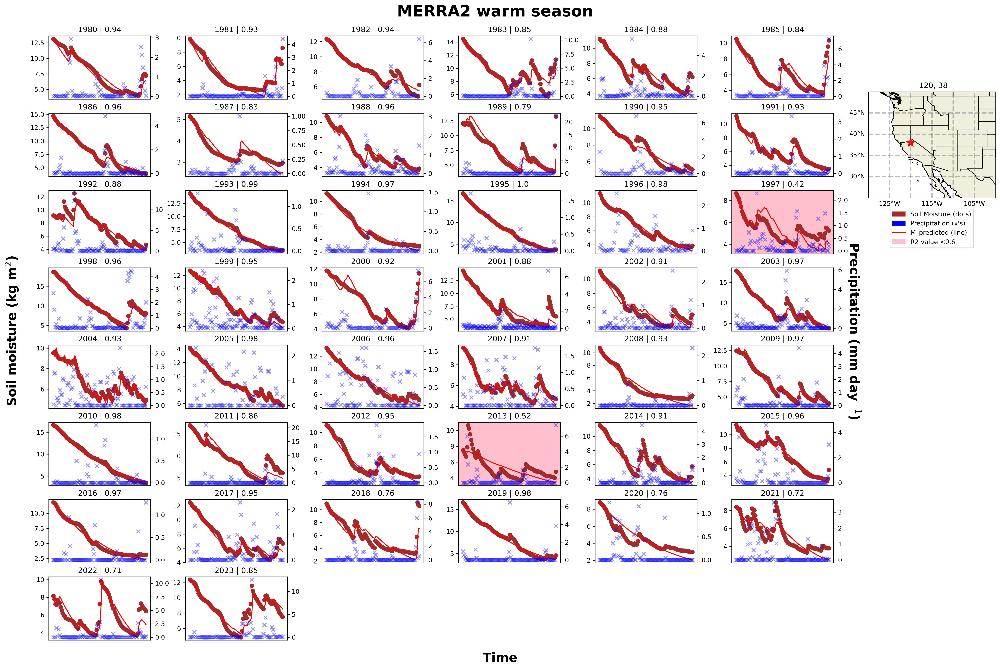

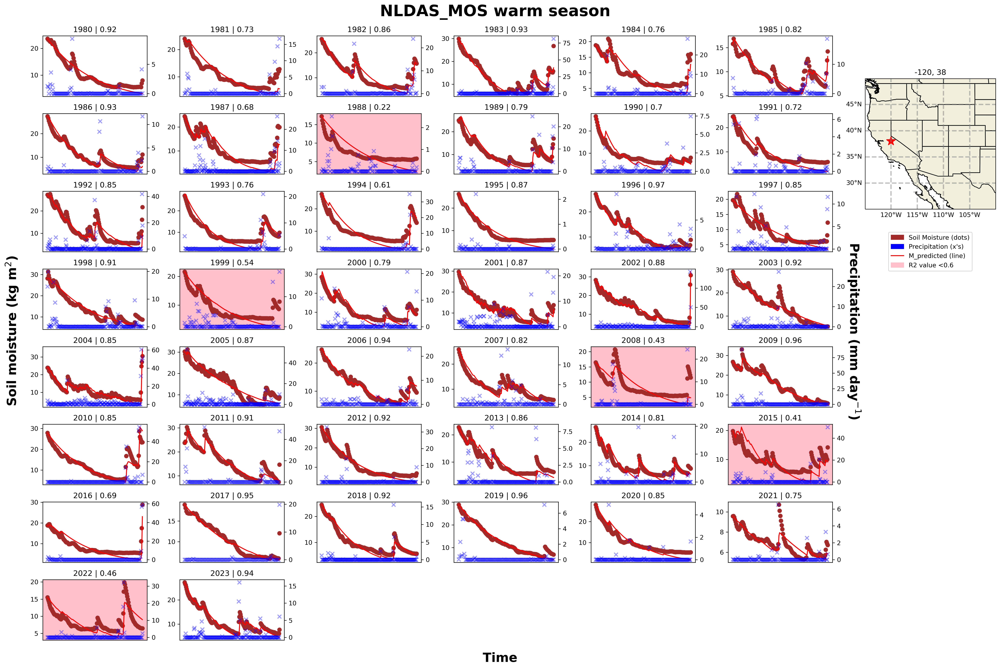

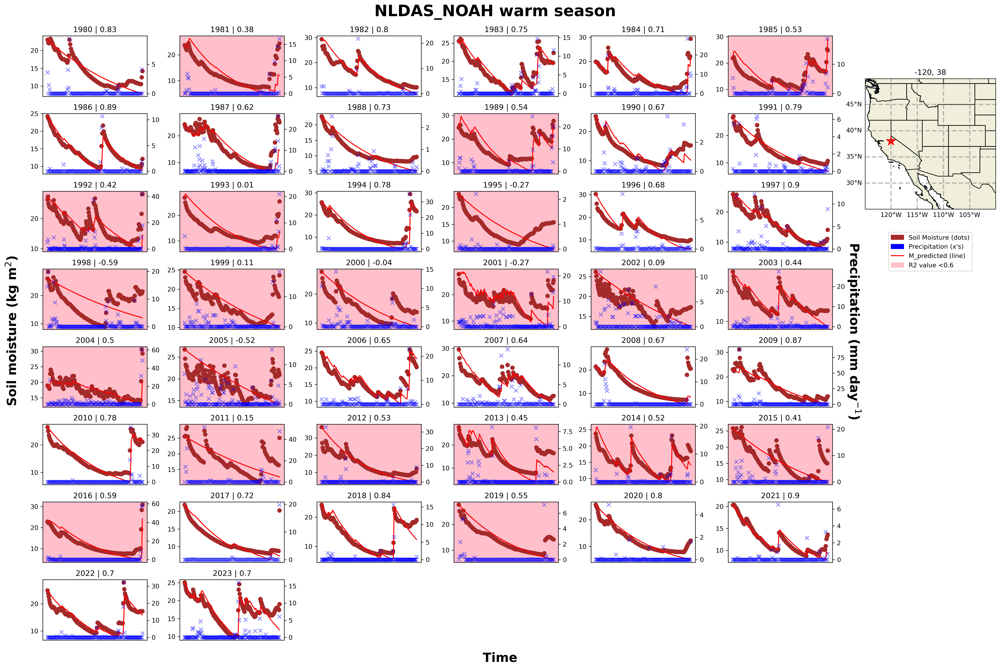

In [27]:
reasonable_fit = 0.8
#lat, lon  = 38, -107
lat, lon = 38, -120
for model in dict_ds.keys():
    
    plot_single_pixel_multi_year(dict_ds[model], model, lat, lon)


## Process full datasets

In [193]:
def process_all_grid_points(ds_model, model, lambda_guess, a_guess):
    """
    Process all grid points in the dataset and fit the drydown model.

    Args:
        ds_region (xarray.Dataset): Input dataset.
        lambda_guess (float): Initial guess for lambda parameter.
        a_guess (float, optional): Initial guess for a parameter.
        model_version (str): Version of the model ('v1', 'v2', or 'v3'). <- not implemented ~ for future work
    Returns:
        xarray.Dataset: Dataset with fitted parameters and metrics.
    """
    results = []

    for year in tqdm(np.unique(ds_model['time.year'])):
        stacked_ds = ds_model.stack(points = ('lat', 'lon')).sel(time = str(year)).copy()
    
        for point in stacked_ds.points:
            lat, lon = point.item()
            if 'year' in stacked_ds.dims:
                ds = stacked_ds.sel(points=point).dropna(dim="time", how="any").sel(year = year)
            else:
                ds = stacked_ds.sel(points=point).dropna(dim = 'time', how = 'any')
            
            try: 
                length_of_season = len(ds.time)
                tau, fitted_lambda, fitted_a, r2 = drydown_params(ds, model, model_params, lambda_guess, a_guess)
                results.append((lat, lon, tau, fitted_lambda, fitted_a, ds['time.year'][0].item(), r2, length_of_season))
            except Exception:
                ## uncomment to except error 
                # traceback.print_exc()
                # print(f'({year}: {lat}, {lon}) failed')
                pass


    return convert_results_to_xarray(results)

def convert_results_to_xarray(results):
    """
    Convert the results into an xarray.Dataset.

    Args:
        results (list of tuples): List of results from processing grid points.
        iterate_seasons (bool): Whether to iterate over seasons.

    Returns:
        xarray.Dataset: Dataset with fitted parameters and metrics.
    """
    # Extract results into separate lists
    # we will only use lats, lons, and years from this 
    lats, lons, tau_vals, a_vals, drydown_vals, years, r2_vals, length_of_season = zip(*results)

    unique_lats = np.unique(lats)
    unique_lons = np.unique(lons)
    unique_years = np.unique(years)
    
    # Create an xarray Dataset
    ds = xr.Dataset({
        'fitted_lambda':    (['lat', 'lon', 'year'], 
                             np.full((len(unique_lats), len(unique_lons), len(unique_years)), np.nan)),
        'fitted_a':         (['lat', 'lon', 'year'], 
                             np.full((len(unique_lats), len(unique_lons), len(unique_years)), np.nan)),
        'tau':              (['lat', 'lon', 'year'], 
                             np.full((len(unique_lats), len(unique_lons), len(unique_years)), np.nan)),
        'r2':               (['lat', 'lon', 'year'], 
                             np.full((len(unique_lats), len(unique_lons), len(unique_years)), np.nan)),
        'length_of_season': (['lat', 'lon', 'year'], 
                             np.full((len(unique_lats), len(unique_lons), len(unique_years)), np.nan))

    }, coords={
        'lat': unique_lats,
        'lon': unique_lons,
        'year': unique_years,
    })

    for lat, lon, tau, lam, a, year, r2, season_length in results:

        lat_idx = np.where(unique_lats == lat)[0][0]
        lon_idx = np.where(unique_lons == lon)[0][0]
        year_idx = np.where(unique_years == year)[0][0]
        
        ds['fitted_lambda'].loc[dict(lat=lat, lon=lon, year=year)] = lam
        ds['fitted_a'].loc[dict(lat=lat, lon=lon, year=year)] = a

        ds['tau'].loc[dict(lat=lat, lon=lon, year=year)] = tau
        ds['r2'].loc[dict(lat=lat, lon=lon, year=year)] = r2
        
        ds['length_of_season'].loc[dict(lat = lat, lon = lon, year = year)] = season_length
        
        ds['fitted_lambda'].attrs['units'] = 'days'
        ds['tau'].attrs['units'] = 'days'
        ds['length_of_season'].attrs['units'] = 'days'
        
        #if 
        #ds['M0'].loc[dict(lat=lat, lon=lon, year=year)] = M0
    
    return ds
    

### Run datasets through drydown model

In [194]:
model_process_dir = 'model_results/'

dict_processed = {}

for model in tqdm(dict_ds.keys()):
#for model in ['MERRA2']:
    fname = f'{proj_dir}{model_process_dir}{model}_warm_season_drydown_model_results.nc'
    if exists(fname):
        print(f'drydown results for {model} already exist, importing')
        ## open dataset
        dict_processed[model] = xr.open_dataset(fname, decode_times = False)
    else:
        ds_model = dict_ds[model]
        dict_processed[model] = process_all_grid_points(ds_model, model, lambda_guess, a_guess)
        dict_processed[model].to_netcdf(fname)

  0%|          | 0/3 [00:00<?, ?it/s]

drydown results for MERRA2 already exist, importing
drydown results for NLDAS_MOS already exist, importing
drydown results for NLDAS_NOAH already exist, importing


## Calculate other definitions of drydown

- v1: mean/median total time period warm season precip / total time period warm season soil moisture 
- v2: mean/median single year warm period precip > 0.001 / single year warm season soil moisture
- v3: mean/median total time period warm season > 0.001 / total time period warm season soil moisture 

rename in drydown dataset 

## Define which version to use for following plots

tau = lambda * np.log(1 + a * seasonal_P_mean/seasonal_M_mean)

In [195]:
### TO DO: 
# - explain how each of these are calculated in the variable attributes 
# - add unit days

### using just tau_v1 for final code, replace model code with this and remove this section

for model in tqdm(dict_processed.keys()):

    ds = dict_processed[model]
    ds_data = dict_ds[model]

    ds['tau_v1'] = ds.fitted_lambda * np.log(1 + (ds.fitted_a * (ds_data[model_params[model]['p_var']]/ds_data[model_params[model]['s_var']]).mean(dim = 'time')))
    ds['tau_v1'].attrs['units'] = 'days'
    ds['tau_v1'].attrs['short_desc'] = 'mean P(full time series)/S(full time series)'
    
    ds['tau_v2'] = ds.fitted_lambda * np.log(1 + (ds.fitted_a * 
                                                  (ds_data[model_params[model]['p_var']].sel(time = slice('1980', '1999'))/ds_data[model_params[model]['s_var']]).sel(time = slice('1980', '1999'))
                                                  .mean(dim = 'time')))
    ds['tau_v2'].attrs['units'] = 'days'
    ds['tau_v2'].attrs['short_desc'] = 'mean P(1980-1999)/S(1980-1999)'

   
    ds['tau_v3'] = ds.fitted_lambda * np.log(1 + (ds.fitted_a * (ds_data[model_params[model]['p_var']]
                                                                 .where(ds_data[model_params[model]['p_var']] > 0.001)/ds_data[model_params[model]['s_var']]).mean(dim = 'time')))
    ds['tau_v3'].attrs['units'] = 'days'
    ds['tau_v3'].attrs['short_desc'] = 'mean P(full time series)>0.001/S(full time series)'
    
    ds['tau_v4'] = ds.fitted_lambda * np.log(1 + (ds.fitted_a * (dict_ds[model][model_params[model]['p_var']]
                                                                 .where(dict_ds[model][model_params[model]['p_var']] > 0.001)/dict_ds[model][model_params[model]['s_var']])
                                                  .groupby('time.year').mean()))
    ds['tau_v4'].attrs['units'] = 'days'
    ds['tau_v4'].attrs['short_desc'] = 'mean P(year)>0.001/S(year)'

    
    dict_processed[model] = ds[['fitted_lambda', 'fitted_a', 'r2', 'length_of_season', 'tau_v1', 'tau_v2', 'tau_v3', 'tau_v4']]                                    

  0%|          | 0/3 [00:00<?, ?it/s]

In [196]:
tau_var = 'tau_v1'

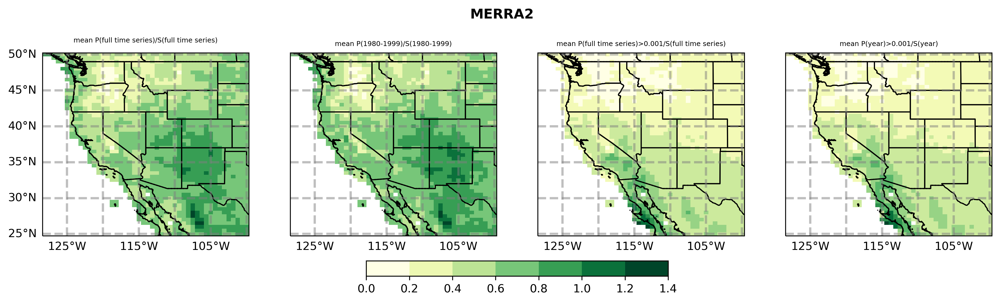

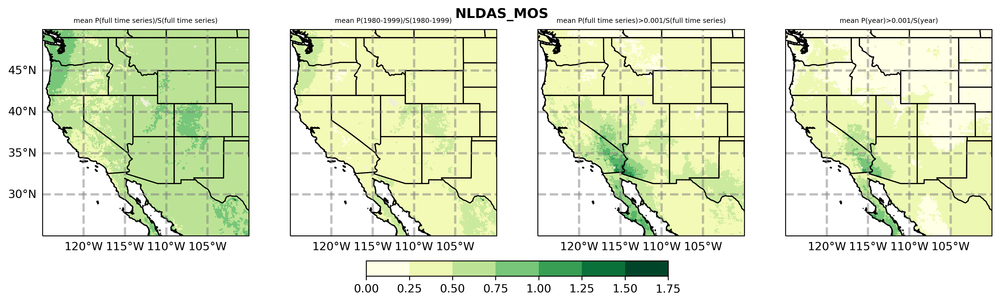

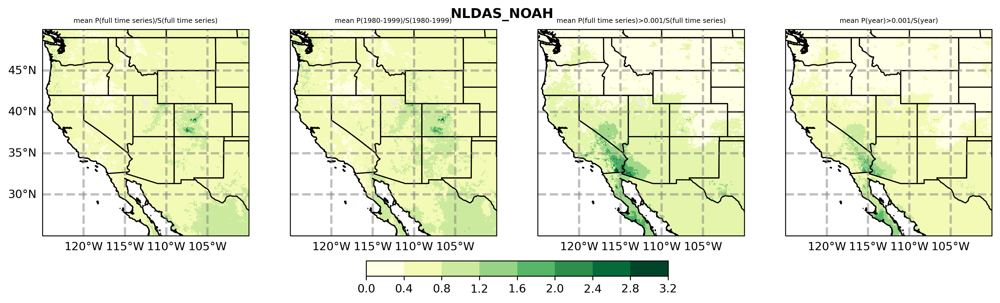

In [197]:
levels = 9 

for model in dict_processed.keys():
    fig, axes = plt.subplots(1, 4, figsize=(15, 8), subplot_kw={"projection": ccrs.PlateCarree()}, dpi = 300)
    
    ds = dict_processed[model]
    
    # Initialize the list to store the plot handles for colorbar
    plot_handles = []
    
    i = 0
    for var in ds.data_vars:
        if 'tau' in var: 
            plot_handle = ds[var].median(dim = 'year').plot(ax = axes[i], cmap = 'YlGn', transform=ccrs.PlateCarree(), 
                                                            levels=levels, 
                                                            add_colorbar = False)
            axes[i].set_title(ds[var].attrs['short_desc'], size = 6)
            i += 1
            plot_handles.append(plot_handle)  # Store the plot handle for colorbar
            
        else:
            pass
    
    j = 0
    for ax in axes.flat:
        # Add map features
        #ax.set_extent(shared_extent, crs=ccrs.PlateCarree())  # Apply the shared extent
    
        ax.coastlines('10m')
        ax.add_feature(cfeature.COASTLINE)
        ax.add_feature(cfeature.STATES)
        ax.add_feature(cfeature.BORDERS, linestyle=':')
        ax.add_feature(cfeature.LAND, edgecolor='black')
    
        gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                          linewidth=2, color='gray', alpha=0.5, linestyle='--')
    
        # Set gridlines labels only on left and bottom
        gl.top_labels = False
        gl.right_labels = False
    
        # Show latitude labels only on the first subplot
        if j == 0:
            gl.left_labels = True
        else:
            gl.left_labels = False
    
        j+=1
    
    # Add the shared colorbar
    cbar = fig.colorbar(plot_handles[0], ax=axes, orientation='horizontal', fraction=0.03, pad=0.05)
    
    plt.suptitle(model, ha='center', va='bottom', fontweight = 'bold', y=0.5)
    plt.show()
              

## Triplots

In [247]:
def tri_plot(dictionary, var, var_name, average = 'median'):
    # Set up a 3x3 figure
    fig, axes = plt.subplots(1, 3, figsize=(15, 15), subplot_kw={"projection": ccrs.PlateCarree()}, dpi=300)
    
    # Define the same extent for all plots
    shared_extent = [-125, -100, 25, 49.2]  # Example extent [lon_min, lon_max, lat_min, lat_max]
    
    # Initialize the list to store the plot handles for colorbar
    plot_handles = []

    model_list = list(dictionary.keys())
    
    drydown_params = {'levels': 9, 
                      'cmap': 'YlGn',
                      #'cmap': 'viridis_r',
                      #'cmap': 'BrBG',
                      'vmin': 0, 
                      'vmax': 1.6, 
                      #'vmax': 4,
                      'unit': 'days'}
    
    r2_params = {'levels': 11, 
                 'cmap': 'magma',
                 'vmin': 0, 
                 'vmax': 1,  
                 'unit': None,
                 'ticks': [0, 0.2, 0.4, 0.6, 0.8, 1.0],
                 'labels': [0, 0.2, 0.4, 0.6, 0.8, 1.0], 
                }

    season_length_params = {'levels': 13, 
                            #'cmap': 'viridis',
                            'cmap': 'Oranges',
                            'vmin': 0, 'vmax': 360,
                            'unit': 'days',
                            'ticks': [0, 60, 120,  180,  240,  300,  360],
                            'labels':[0, 60, 120,  180,  240,  300,  360]}

    if 'tau' in var:
    #if var == 'tau':
        cmin = drydown_params['vmin']
        cmax = drydown_params['vmax']
        levels = drydown_params['levels']
        unit = drydown_params['unit']
        cmap = drydown_params['cmap']
        ticks = None
        labels = None
    
    
    elif var == 'r2':
        cmin = r2_params['vmin']
        cmax = r2_params['vmax']
        levels = r2_params['levels']
        unit = r2_params['unit']
        cmap = r2_params['cmap']
        ticks = None
        labels = None

    elif (var == 'length_of_season') :
        cmap = season_length_params['cmap']
        levels = season_length_params['levels']
        cmin = season_length_params['vmin']; cmax = season_length_params['vmax']
        ticks = season_length_params['ticks']
        labels = season_length_params['labels']
        unit = season_length_params['unit']

    elif var == 'fitted_a':
        cmin = r2_params['vmin']
        cmax = r2_params['vmax']
        levels = r2_params['levels']
        unit = r2_params['unit']
        cmap = 'BuPu'
        ticks = None
        labels = None

    elif var == 'fitted_lambda':
        cmin = drydown_params['vmin']
        cmax = 400
        levels = drydown_params['levels']
        unit = drydown_params['unit']
        cmap = drydown_params['cmap']
        ticks = None
        labels = None

    else:
        cmin = None
        cmax = None
        levels = 9
        unit = None
        cmap = 'Greens'
        ticks = None
        labels = None 


    j = 0 

    
    #for j, (model, model_name) in enumerate(zip(dict_processed.items(), dict_processed.keys())):  # Columns correspond to models
    for model_name, model in dictionary.items():
        ax = axes[j]  # Access the current subplot

        if average == 'mean':
            # Plot the slope on the current axis
            plot_handle = model[var].mean(dim='year').plot(
                ax=ax, transform=ccrs.PlateCarree(), add_colorbar=False, 
                cmap = cmap,
                levels=levels, 
                vmin=cmin, vmax=cmax
            )
        if average == 'median':
            plot_handle = model[var].median(dim='year').plot(
                ax=ax, transform=ccrs.PlateCarree(), add_colorbar=False, 
                cmap = cmap,
                levels=levels, 
                vmin=cmin, vmax=cmax
            )
            
        plot_handles.append(plot_handle)  # Store the plot handle for colorbar
        
        ax.set_title(model_params[model_name]['model_name'], fontweight='bold')
        
        # Add map features
        ax.set_extent(shared_extent, crs=ccrs.PlateCarree())  # Apply the shared extent
    
        ax.coastlines('10m')
        ax.add_feature(cfeature.COASTLINE)
        ax.add_feature(cfeature.STATES)
        ax.add_feature(cfeature.BORDERS, linestyle=':')
        ax.add_feature(cfeature.LAND, edgecolor='black')
    
        gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                          linewidth=2, color='gray', alpha=0.5, linestyle='--')
    
        # Subplot lettering from Kevin S
        ax.text(0.01, 0.98, string.ascii_letters[model_list.index(model_name)] + '.',
                transform=ax.transAxes, ha='left', va='top',
                fontsize=18, fontweight='bold',
                bbox={'boxstyle': 'round',
                      'facecolor': 'white',
                      'alpha': 0.8,
                      'edgecolor': 'None',
                      'pad': 0.2})
    
        # Set gridlines labels only on left and bottom
        gl.top_labels = False
        gl.right_labels = False

        # Show latitude labels only on the first subplot
        if j == 0:
            gl.left_labels = True
        else:
            gl.left_labels = False

        j+=1
        
        
        #if ('tau', 'fitted_a', 'fitted_lambda') in var:
        if any(v in var for v in ('tau', 'fitted_a', 'fitted_lambda')):
            # Define where to apply hatch marks
            # hashing where r2 < 0.6
            low_r2_mask = model['r2'].median(dim = 'year') < 0.5
            ax.contourf(
                low_r2_mask.lon, low_r2_mask.lat, low_r2_mask.astype(int), 
                levels=[-0.5, 0.5, 1.5],
                hatches=['', '////'],  # '////' creates angled hash lines
                #hatches=['', 'xx'],
                #hatches=['', '\\\\'],
                colors='none',  # Transparent fill
                transform=ccrs.PlateCarree(),
                zorder=5
            )
    
    
    # Add the shared colorbar
    cbar = fig.colorbar(plot_handles[0], ax=axes, orientation='horizontal', fraction=0.03, pad=0.05)


        
    # if '_' in var:
    #     var_name = var.replace("_", " ")

    # elif 'season' in var:
    #     var_name = 'length of warm season'

    # elif 'r2' in var:
    #     var_name = 'R$^2$'
        
    # else:
    #     var_name = var


    # if 'tau' in var:
    #     #var_name = 'drydown'
    #     var_name = 'τ, drydown'
    
    # Label the colorbar
    if unit == None:
        cbar.set_label(f'median {var_name}', fontsize=14, labelpad=10)  

    else: 
        cbar.set_label(f'median {var_name} ({unit})', fontsize=14, labelpad=10)  

    
    if (ticks is not None) & (labels is not None):        
        cbar.set_ticks(ticks = ticks, labels = labels)

    fig.savefig(f'{fig_save_dir}tri_plot_{var}.png', bbox_inches='tight')

    plt.show()

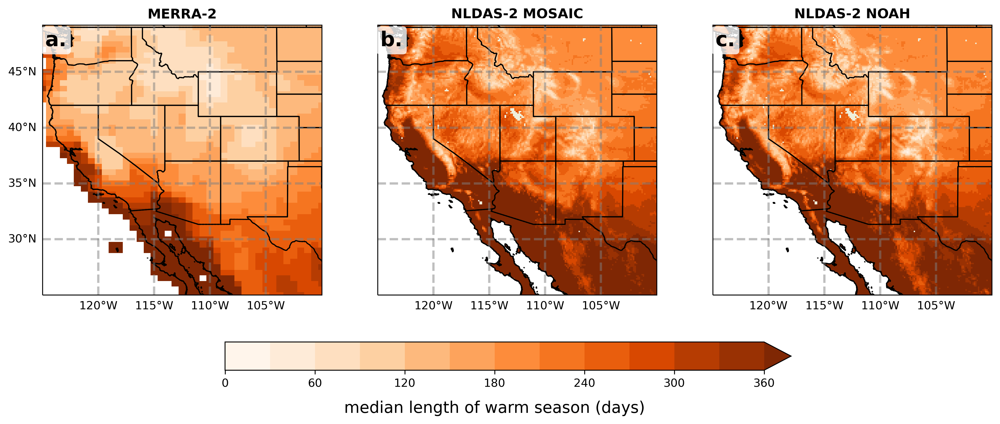

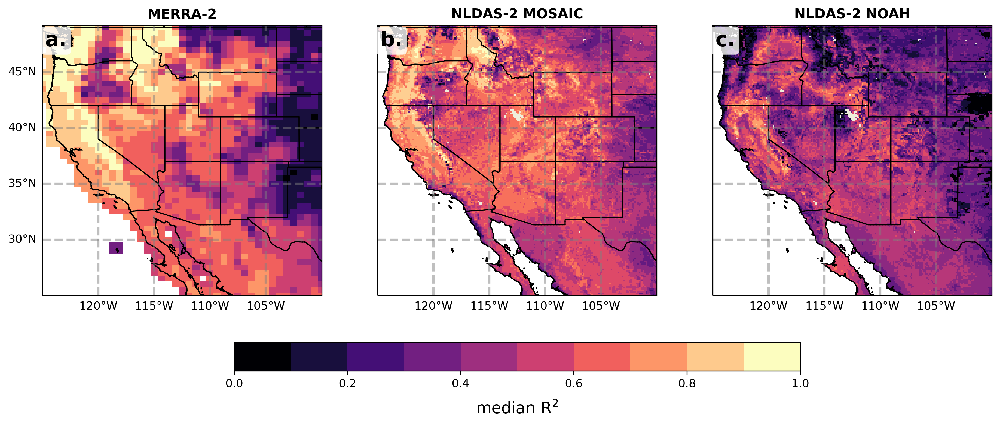

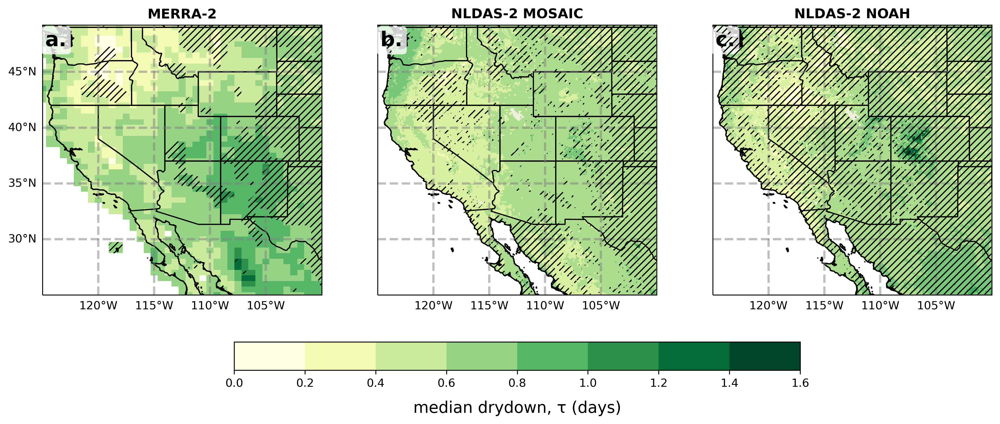

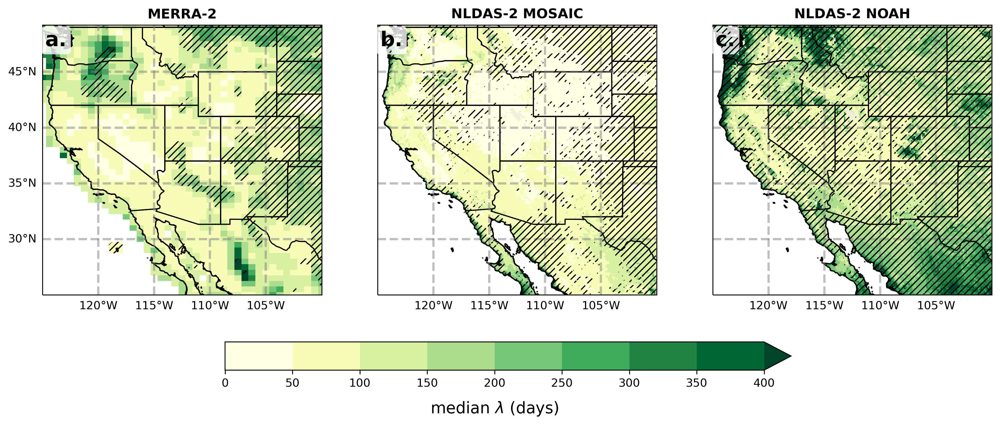

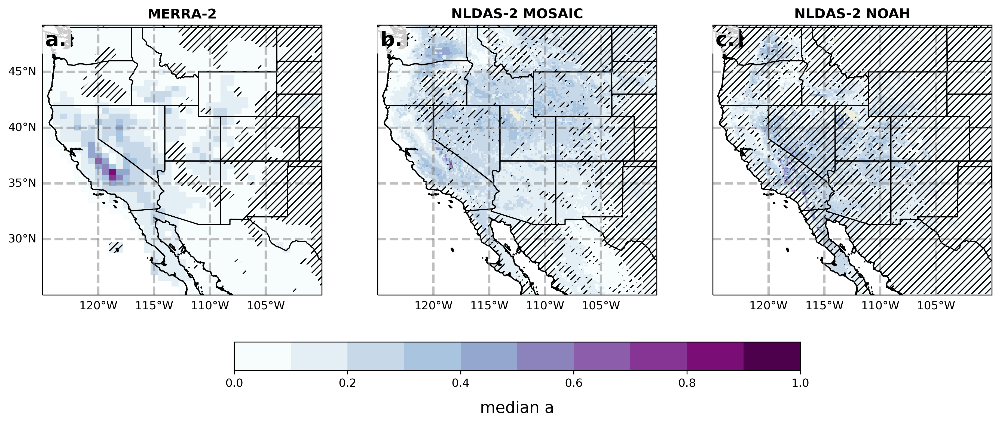

In [248]:
tri_plot(dict_processed, 'length_of_season', 'length of warm season')
tri_plot(dict_processed, 'r2', 'R$^2$')
tri_plot(dict_processed, 'tau_v1', 'drydown, τ')
tri_plot(dict_processed, 'fitted_lambda', '$\lambda$')
tri_plot(dict_processed, 'fitted_a', 'a')


In [60]:
def tri_plot_dataset(var, var_name, average = 'median'):
    # Set up a 3x3 figure
    fig, axes = plt.subplots(1, 3, figsize=(15, 15), subplot_kw={"projection": ccrs.PlateCarree()}, dpi=300)
    
    # Row and column labels
    models = dict_ds.keys()
    
    ### increasing shared extent from [-125, -100, 25, 49.2] to leave room for the plot letters 
    shared_extent = [-127, -100, 25, 49.2] # [lon_min, lon_max, lat_min, lat_max]
    
    # Initialize the list to store the plot handles for colorbar
    plot_handles = []

    levels = 9 

    try:
        unit = dict_ds['MERRA2'][model_params['MERRA2'][var]].attrs['units']
    except: 
        unit = None

    if var_name == 'Precipitation':
        cmap = 'PuBu'
        cmin = 0
        cmax = None
    elif var_name == 'Temperature':
        cmap = 'Reds'
        cmin = 0
        cmax = 40
    elif var_name == 'Surface Soil Moisture':
        cmap = 'Greens'
        cmin = 0
        cmax = 40

    else:
        cmap = 'viridis'
        cmin = 0
        cmax = 10
    

    for j, model in enumerate(models):  # Columns correspond to models
        ax = axes[j]  # Access the current subplot
        
        if average == 'mean':
            # Plot the slope on the current axis
            plot_handle = dict_ds[model][model_params[model][var]].mean(dim='time').plot(
                ax=ax, transform=ccrs.PlateCarree(), add_colorbar=False, 
                cmap = cmap,
                levels=levels, 
                vmin=cmin, vmax=cmax)
            
        if average == 'median':
            plot_handle = dict_ds[model][model_params[model][var]].median(dim='time').plot(
                ax=ax, transform=ccrs.PlateCarree(), add_colorbar=False, 
                cmap = cmap,
                levels=levels, 
                vmin=cmin, vmax=cmax)
            
        plot_handles.append(plot_handle)  # Store the plot handle for colorbar
        
        ax.set_title(model_params[model]['model_name'], fontweight='bold')
        
        # Add map features
        ax.set_extent(shared_extent, crs=ccrs.PlateCarree())  # Apply the shared extent
    
        ax.coastlines('10m')
        ax.add_feature(cfeature.COASTLINE)
        ax.add_feature(cfeature.STATES)
        ax.add_feature(cfeature.BORDERS, linestyle=':')
        ax.add_feature(cfeature.LAND, edgecolor='black')
    
        gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                          linewidth=2, color='gray', alpha=0.5, linestyle='--')
    
        # Subplot lettering from Kevin S
        ax.text(0.01, 0.98, string.ascii_letters[list(models).index(model)] + '.',
                transform=ax.transAxes, ha='left', va='top',
                fontsize=18, fontweight='bold',
                bbox={'boxstyle': 'round',
                      'facecolor': 'white',
                      'alpha': 0.8,
                      'edgecolor': 'None',
                      'pad': 0.2})
    
        # Set gridlines labels only on left and bottom
        gl.top_labels = False
        gl.right_labels = False

        # Show latitude labels only on the first subplot
        if j == 0:
            gl.left_labels = True
        else:
            gl.left_labels = False
        
    
    # Add the shared colorbar
    cbar = fig.colorbar(plot_handles[0], ax=axes, orientation='horizontal', fraction=0.03, pad=0.05)

    # Label the colorbar
    if unit == None:
        cbar.set_label(f'{var_name}', fontsize=14, labelpad=10)  

    else: 
        cbar.set_label(f'{var_name} ({unit})', fontsize=14, labelpad=10)  

    fig.savefig(f'{fig_save_dir}_tri_plot_{var}.png', bbox_inches='tight')

    plt.show()


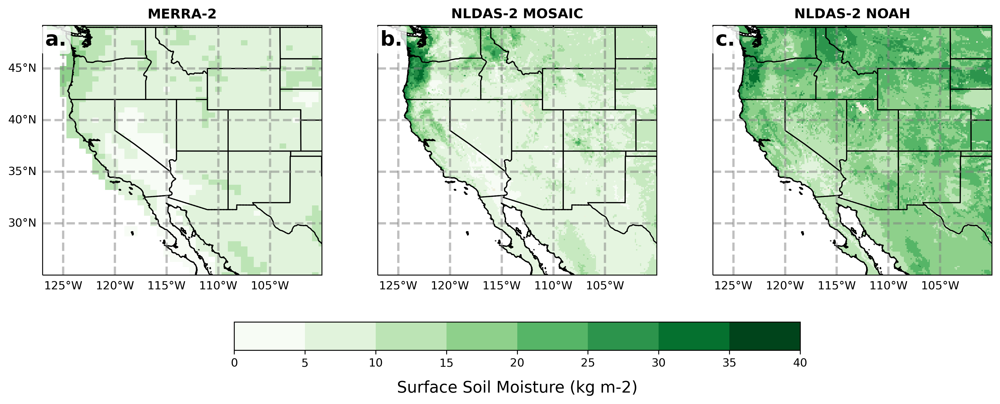

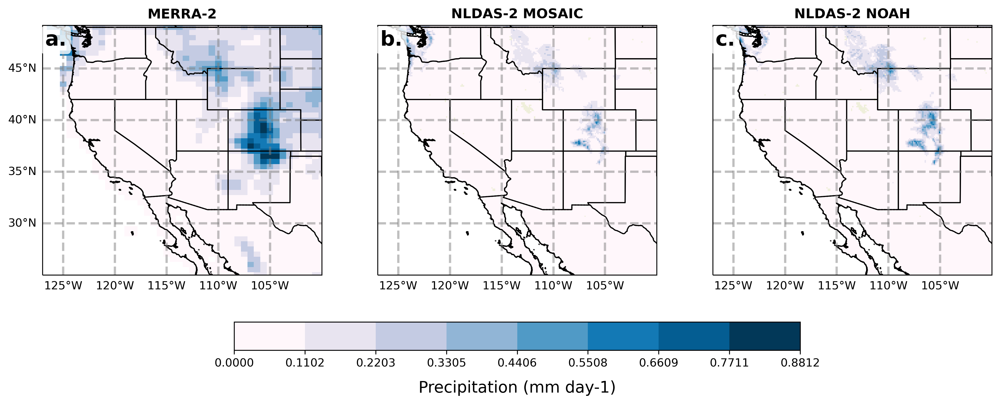

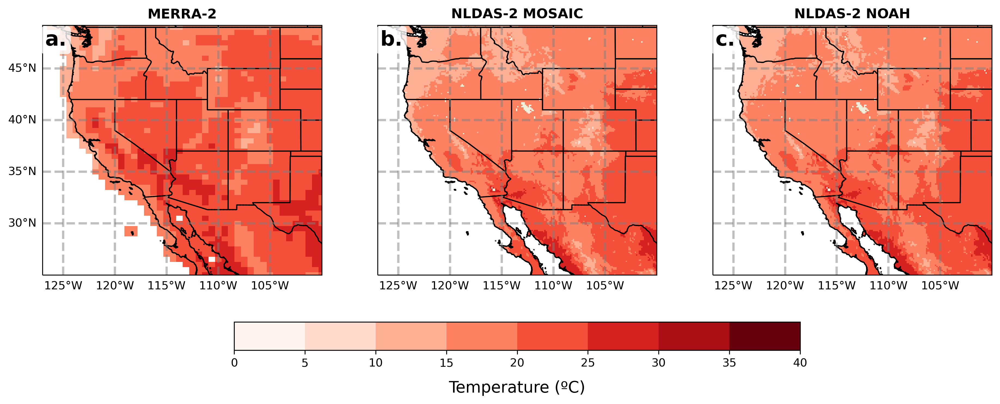

In [61]:
tri_plot_dataset('s_var', 'Surface Soil Moisture', 'median')
tri_plot_dataset('p_var', 'Precipitation', 'median')
tri_plot_dataset('t_var', 'Temperature', 'median')


## 2004-2023 - 1980-2000

In [62]:
dict_trend = {}

for model in dict_processed.keys():
    dict_trend[model] = (dict_processed[model].sel(year = slice(2004, 2023)).median(dim = 'year') - dict_processed[model].sel(year = slice(1980, 1999))).median(dim = 'year')

In [63]:
print(dict_trend['NLDAS_MOS'].length_of_season.max())
dict_trend['NLDAS_MOS'].length_of_season.argmax(dim = ['lat', 'lon'])

<xarray.DataArray 'length_of_season' ()>
array(62.)


{'lat': <xarray.DataArray 'length_of_season' ()>
 array(6),
 'lon': <xarray.DataArray 'length_of_season' ()>
 array(147)}

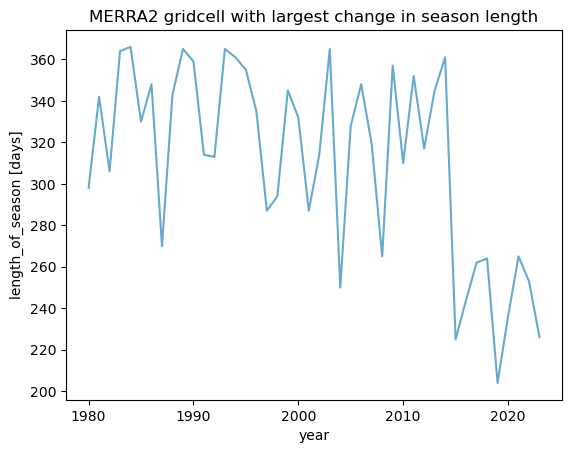

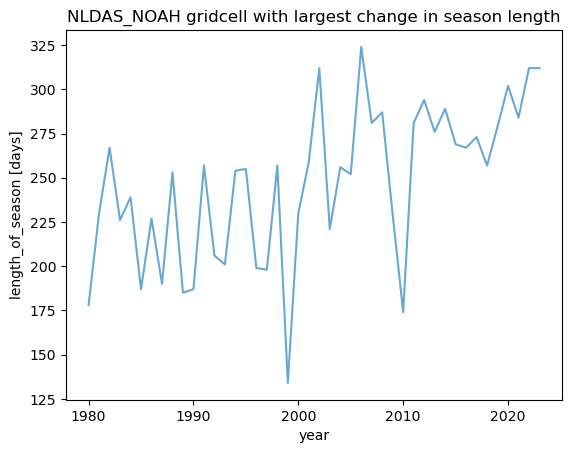

Text(0.5, 1.0, 'NLDAS_MOS gridcell with largest change in season length')

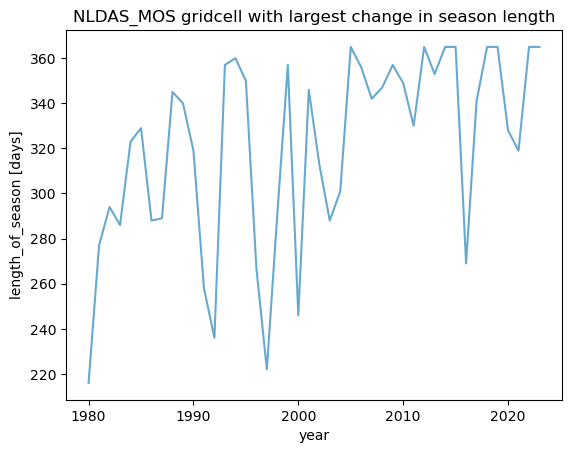

In [64]:
dict_processed['MERRA2'].isel(lat = 2, lon = 33).length_of_season.plot()
plt.title('MERRA2 gridcell with largest change in season length')
plt.show()
#dict_processed['MERRA2'].isel(lat = 19, lon = 22).length_of_season.plot()

dict_processed['NLDAS_NOAH'].isel(lat = 9, lon = 149).length_of_season.plot()
plt.title('NLDAS_NOAH gridcell with largest change in season length')
plt.show()

dict_processed['NLDAS_MOS'].isel(lat = 6, lon = 147).length_of_season.plot()
plt.title('NLDAS_MOS gridcell with largest change in season length')

In [65]:

def tri_plot_trend(dictionary, var, average = 'median'):
    # Set up a 3x3 figure
    fig, axes = plt.subplots(1, 3, figsize=(15, 15), subplot_kw={"projection": ccrs.PlateCarree()}, dpi=300)
    
    # Define the same extent for all plots
    shared_extent = [-125, -100, 25, 49.2]  # Example extent [lon_min, lon_max, lat_min, lat_max]
    
    # Initialize the list to store the plot handles for colorbar
    plot_handles = []

    model_list = list(dictionary.keys())
    
    drydown_params = {'levels': 9, 
                      #'cmap': 'YlGn',
                      #'cmap': 'viridis_r',
                      'cmap': 'BrBG',
                      'vmin': -1, 
                      #'vmax': 1.6, 
                      'vmax': 1,
                      'unit': 'days'}
    
    r2_params = {'levels': 11, 
                 'cmap': 'magma',
                 'vmin': -1, 
                 'vmax': 1,  
                 'unit': None,
                 'ticks': [0, 0.2, 0.4, 0.6, 0.8, 1.0],
                 'labels': [0, 0.2, 0.4, 0.6, 0.8, 1.0], 
                }

    season_length_params = {'levels': 13, 
                            #'cmap': 'viridis',
                            #'cmap': 'Oranges',
                            #'cmap': 'BrBG',
                            'cmap': 'PuOr',
                            'vmin': -50, 'vmax': 50,
                            'unit': 'days',
                            'ticks': None,
                            'labels': None}
                            #'ticks': [0, 60, 120,  180,  240,  300,  360],
                            #'labels':[0, 60, 120,  180,  240,  300,  360]}
    
    if 'tau' in var:
        cmin = drydown_params['vmin']
        cmax = drydown_params['vmax']
        levels = drydown_params['levels']
        unit = drydown_params['unit']
        cmap = drydown_params['cmap']
        ticks = None
        labels = None
    
    
    if var == 'r2':
        cmin = r2_params['vmin']
        cmax = r2_params['vmax']
        levels = r2_params['levels']
        unit = r2_params['unit']
        cmap = r2_params['cmap']
        ticks = None
        labels = None

    if (var == 'length_of_season') :
        cmap = season_length_params['cmap']
        levels = season_length_params['levels']
        cmin = season_length_params['vmin']; cmax = season_length_params['vmax']
        ticks = season_length_params['ticks']
        labels = season_length_params['labels']
        unit = season_length_params['unit']

    if var == 'fitted_a':
        cmin = r2_params['vmin']
        cmax = r2_params['vmax']
        levels = r2_params['levels']
        unit = r2_params['unit']
        cmap = 'BuPu'
        ticks = None
        labels = None

    if var == 'fitted_lambda':
        cmin = -100
        cmax = 100
        levels = drydown_params['levels']
        unit = drydown_params['unit']
        cmap = drydown_params['cmap']
        ticks = None
        labels = None


    j = 0 
    #for j, (model, model_name) in enumerate(zip(dict_processed.items(), dict_processed.keys())):  # Columns correspond to models
    for model_name, model in dictionary.items():
        ax = axes[j]  # Access the current subplot

        # if average == 'mean':
        #     # Plot the slope on the current axis
        #     plot_handle = model[var].mean(dim='year').plot(
        #         ax=ax, transform=ccrs.PlateCarree(), add_colorbar=False, 
        #         cmap = cmap,
        #         levels=levels, 
        #         vmin=cmin, vmax=cmax
        #     )
        # if average == 'median':
        #     plot_handle = model[var].median(dim='year').plot(
        #         ax=ax, transform=ccrs.PlateCarree(), add_colorbar=False, 
        #         cmap = cmap,
        #         levels=levels, 
        #         vmin=cmin, vmax=cmax
        #     )

        plot_handle = model[var].plot(
                ax=ax, transform=ccrs.PlateCarree(), add_colorbar=False, 
                cmap = cmap,
                levels=levels, 
                vmin=cmin, vmax=cmax
            )
        
            
        plot_handles.append(plot_handle)  # Store the plot handle for colorbar
        
        ax.set_title(model_name, fontweight='bold')
        
        # Add map features
        ax.set_extent(shared_extent, crs=ccrs.PlateCarree())  # Apply the shared extent
    
        ax.coastlines('10m')
        ax.add_feature(cfeature.COASTLINE)
        ax.add_feature(cfeature.STATES)
        ax.add_feature(cfeature.BORDERS, linestyle=':')
        ax.add_feature(cfeature.LAND, edgecolor='black')
    
        gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                          linewidth=2, color='gray', alpha=0.5, linestyle='--')
    
        # Subplot lettering from Kevin S
        ax.text(0.01, 0.98, string.ascii_letters[model_list.index(model_name)] + '.',
                transform=ax.transAxes, ha='left', va='top',
                fontsize=18, fontweight='bold',
                bbox={'boxstyle': 'round',
                      'facecolor': 'white',
                      'alpha': 0.8,
                      'edgecolor': 'None',
                      'pad': 0.2})
    
        # Set gridlines labels only on left and bottom
        gl.top_labels = False
        gl.right_labels = False

        # Show latitude labels only on the first subplot
        if j == 0:
            gl.left_labels = True
        else:
            gl.left_labels = False

        j+=1
        
    
    # Add the shared colorbar
    cbar = fig.colorbar(plot_handles[0], ax=axes, orientation='horizontal', fraction=0.03, pad=0.05)


        
    if '_' in var:
        var_name = var.replace("_", " ")

    elif 'season' in var:
        var_name = 'length of warm season'

    elif 'r2' in var:
        var_name = 'R$^2$'
        
    else:
        var_name = var
    
    # Label the colorbar
    if unit == None:
        cbar.set_label(f'{var_name}', fontsize=14, labelpad=10)  

    else: 
        cbar.set_label(f'{var_name} ({unit})', fontsize=14, labelpad=10)  

    
    if (ticks is not None) & (labels is not None):        
        cbar.set_ticks(ticks = ticks, labels = labels)

    fig.savefig(f'{fig_save_dir}_tri_plot_trend{var}.png', bbox_inches='tight')

    plt.show()

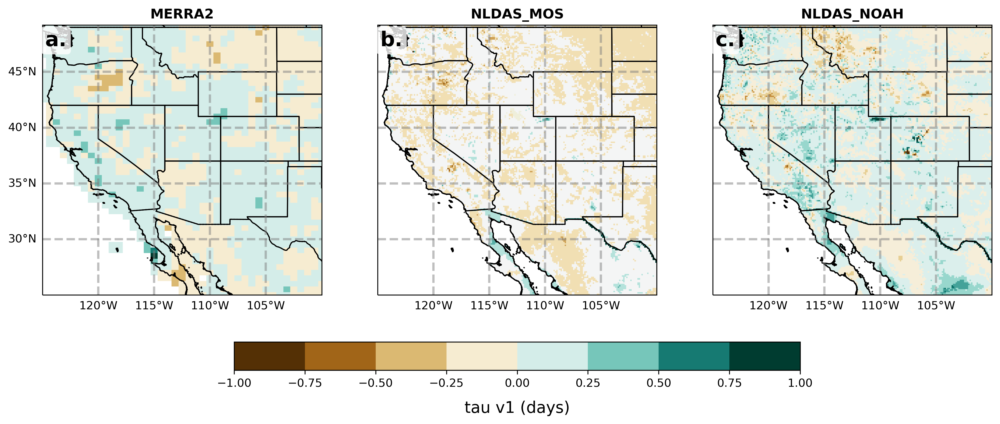

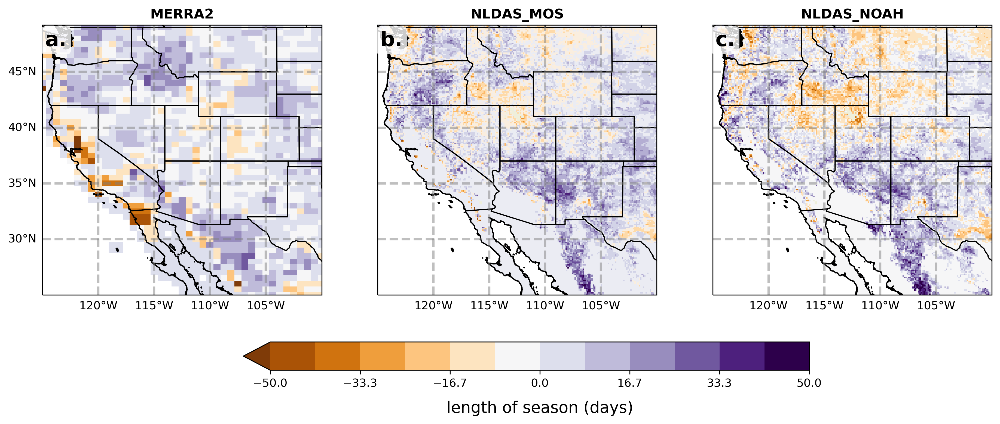

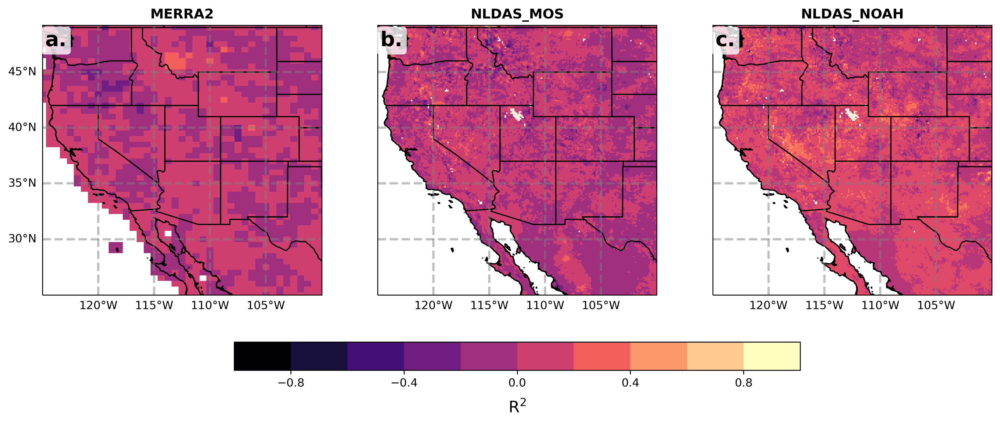

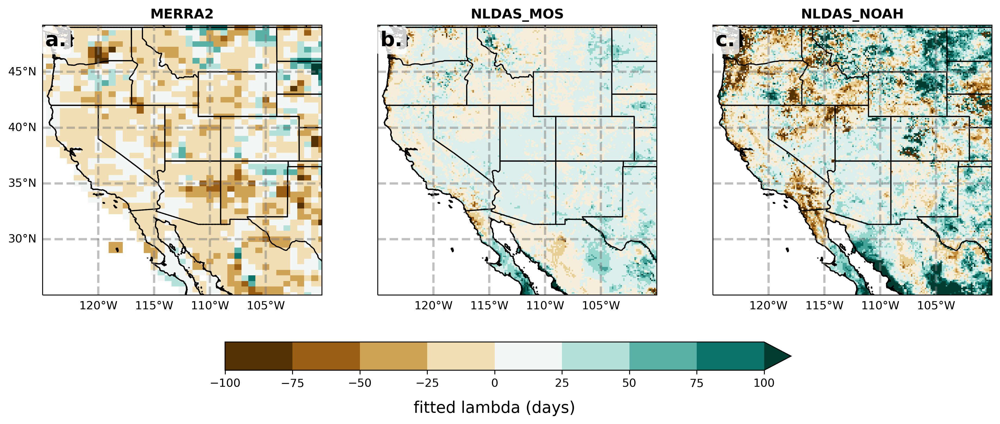

In [66]:
tri_plot_trend(dict_trend, 'tau_v1')
tri_plot_trend(dict_trend, 'length_of_season')
tri_plot_trend(dict_trend, 'r2')
tri_plot_trend(dict_trend, 'fitted_lambda')

Text(0.5, 1.0, 'global mean season length')

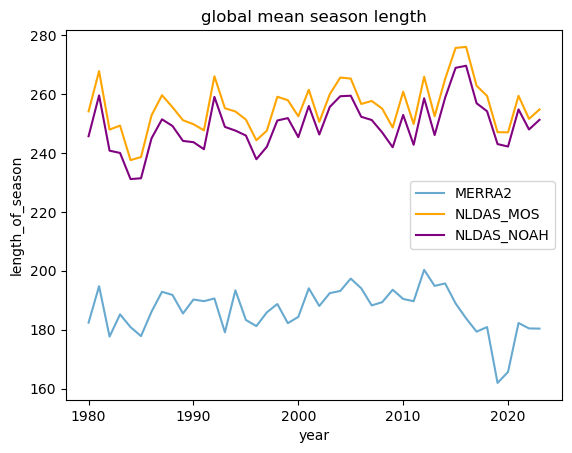

In [67]:
for model in dict_processed.keys():
    global_mean(dict_processed[model]).length_of_season.plot(label = model)
plt.legend()
plt.title('global mean season length')

## Boxplots

- ADD SAVE LINE 

In [68]:
# Function to convert xarray to pandas and add columns for model and season
def process_dataset(ds, model_name):
    return (ds.to_dataframe()
            .dropna()
            .reset_index()
            .assign(model=model_name))

In [69]:
models_list = []

for model in dict_processed.keys():
    models_list.append(process_dataset(dict_processed[model], model))

In [70]:
# Combine all datasets into one dataframe
combined_df = pd.concat(models_list, ignore_index=True)

In [71]:
import seaborn as sns


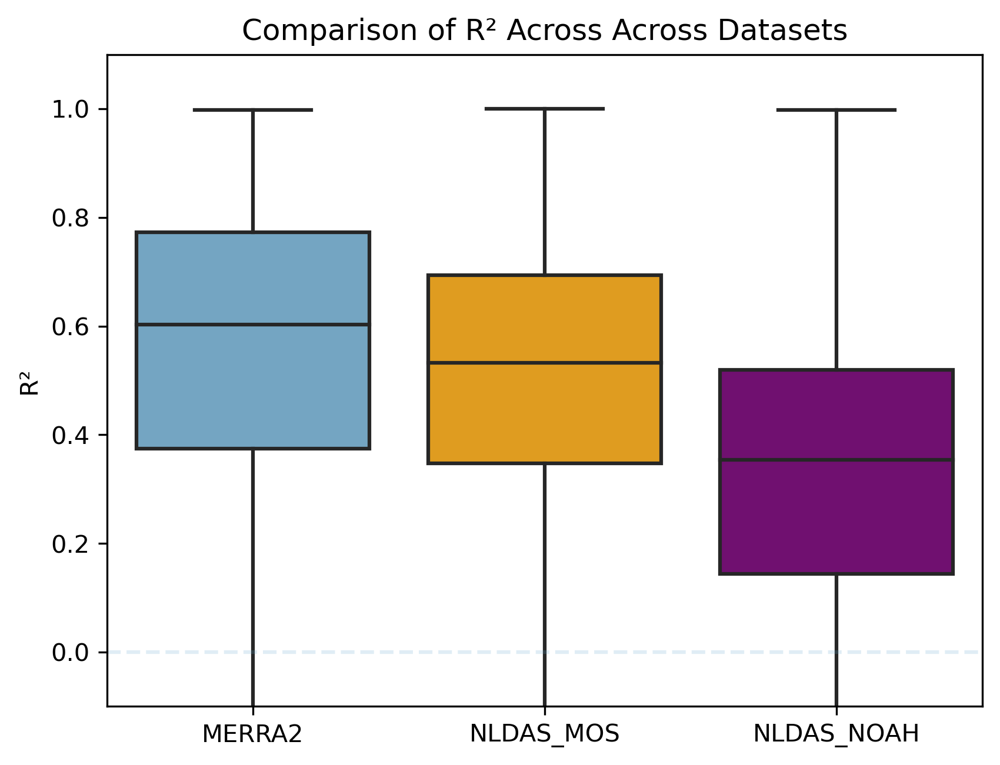

In [72]:
plt.figure(dpi=300)

data = combined_df[['fitted_lambda', 'fitted_a', 'tau_v1', 'length_of_season', 'model','r2']]

sns.boxplot(x='model', y='r2', data=data)

plt.ylim(-0.1, 1.1)
plt.axhline(y = 0, linestyle = '--', alpha = 0.2)

plt.xlabel(None)
plt.ylabel('R²')
plt.title('Comparison of R² Across Across Datasets')

plt.savefig(f'{fig_save_dir}_R2_comparison.png', bbox_inches='tight')
plt.show()

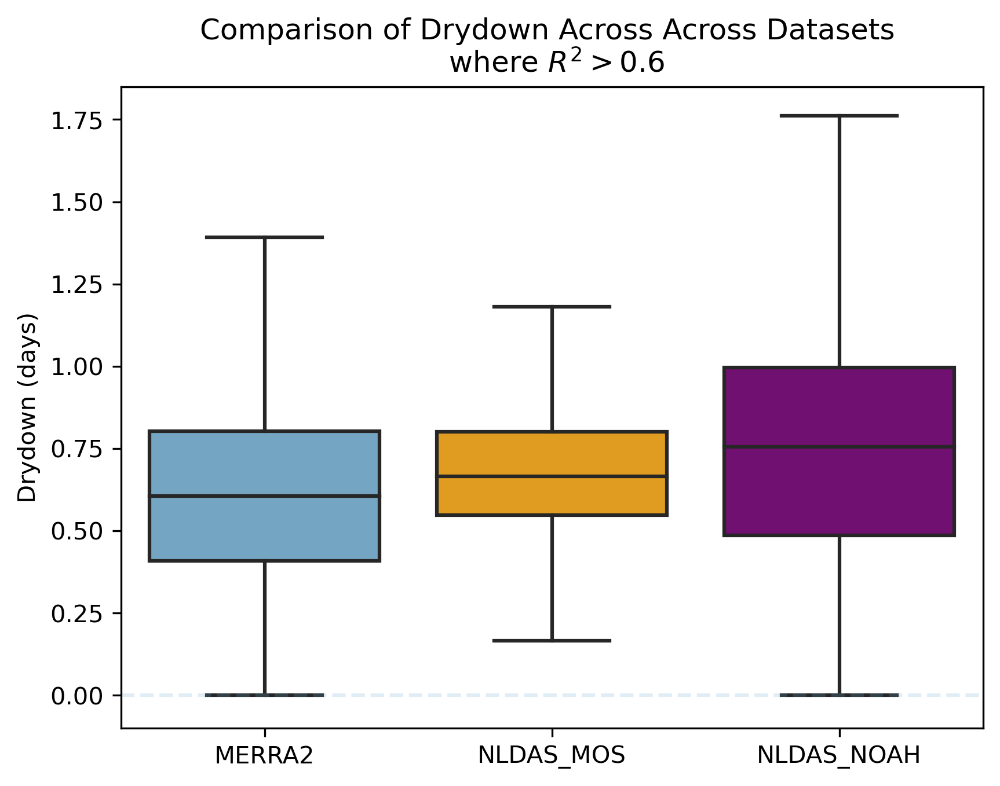

NOAH: 0.754505689193989
MOSAIC: 0.6649224270104617


In [73]:
plt.figure(dpi=300)

data = combined_df[['fitted_lambda', 'fitted_a', 'tau_v1', 'length_of_season', 'model','r2']]
filtered_data = data[data['r2'] > 0.6]
sns.boxplot(x='model', y='tau_v1', data=filtered_data, showfliers=False)
#sns.boxenplot(x='model', y='drydown', data=data, showfliers=False)

plt.ylim(-0.1, )

plt.axhline(y = 0, linestyle = '--', alpha = 0.2)

plt.xlabel(None)
plt.ylabel('Drydown (days)')
plt.title('Comparison of Drydown Across Across Datasets \n where $R^2 > 0.6$')


plt.savefig(f'{fig_save_dir}_drydown_filtered_comparison.png', bbox_inches='tight')

plt.show()

print('NOAH: ' + str(filtered_data[filtered_data['model'] == 'NLDAS_NOAH'].tau_v1.median()))
print('MOSAIC: ' + str(filtered_data[filtered_data['model'] == 'NLDAS_MOS'].tau_v1.median()))

Text(0.5, 1.0, 'Drydown where $R^2 > 0.6$')

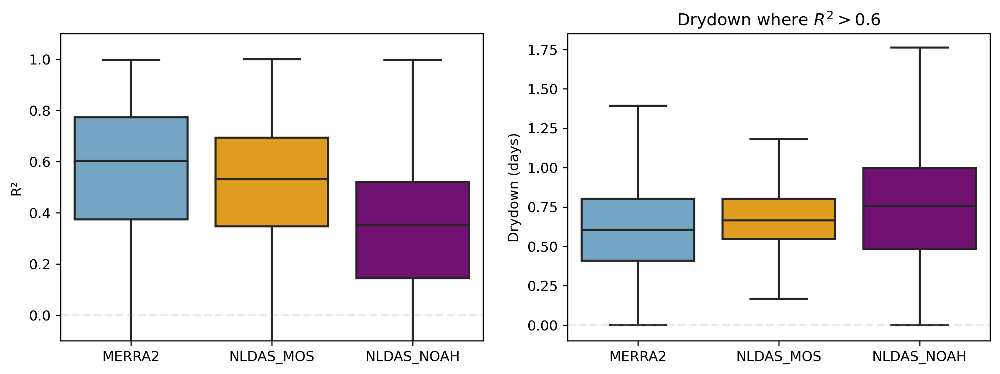

In [74]:
model_colors = {'NLDAS_NOAH': 'orange', 'NLDAS_MOS': 'purple'}  # Adjust colors as needed

colors = ['#67a9cf', 'orange', 'purple']
sns.set_palette(sns.color_palette(colors))


fig, ax = plt.subplots(ncols = 2, dpi = 300, figsize = (12, 4))

data = combined_df[['fitted_lambda', 'fitted_a', 'tau_v1', 'length_of_season', 'model','r2']]
filtered_data = data[data['r2'] > 0.5]


sns.boxplot(x='model', y='r2', data=data, ax = ax[0])
sns.boxplot(x='model', y='tau_v1', data=filtered_data, showfliers=False, ax =ax[1])


ax[0].set_ylim(-0.1, 1.1)
ax[0].axhline(y = 0, linestyle = '--', alpha = 0.2)

ax[0].set_xlabel(None)
ax[0].set_ylabel('R²')


ax[1].set_ylim(-0.1, )

ax[1].axhline(y = 0, linestyle = '--', alpha = 0.2)

ax[1].set_xlabel(None)
ax[1].set_ylabel('Drydown (days)')
ax[1].set_title('Drydown where $R^2 > 0.5$')

